# Solving Monty Hall problem with quantum computing
$\textit{by 'Paradox' hackaton group}$ 

The objective of this notebook is to carry out an analysis of the Monty Hall problem, and relate it to different quantum algorithms. Throughout the notebook, we will describe the problem and gives its mathematical formulation.

After that, we will proceed to pose the problem so that it can be solved with quantum computing. We will design an algorithm and analyze its advantages and disadvantages. Finally, it will be concluded whether the quantum algorithm achieves an advantage in reference to the classical algorithm, and next steps to further improve it.

## 1. Raising the Monty Hall problem

We are participating in a famous television game. The player must choose one door among three (all closed); The prize consists of taking what is behind the chosen one. It is known with certainty that a car is hidden behind one of them, and goats are hidden behind the other two. Once the player has chosen a door and communicated his choice, the presenter, who knows what is behind each door, will open one of the other two, in which there will be a goat. Next, it gives the player the option to change the door, if they wish. Should the contestant keep his or her original choice or choose the other door? Is there a solution that is most convenient for him?

To represent this problem, we define a function $f(x)=y$,where $x,y \in \{001,010,100\}$. This function represents the first decision of one of the possible three doors, with $x$ being the string that represents this choice. The position where the value $1$ is found in the string indicates which door was chosen. The output $y$ represents which door is the one that, after our choice, the presenter opens.

Suppose we choose the door on the left and then the presenter decides to open the middle door to later give us the option to change to the remaining door. This described process can be represented as $f(100)=010$.

The most important thing is the function $g(x)$, described below. This function represents the last decision we make whether to change or stay at the originally chosen door. It has the form $g(x)=z,$ where $ x \in \{001,010,100\} - {y}, z \in \{0,1\}$. That is, $x$ represents the choice of whether to stay at the current door or move. Note that the range of values of $x$ does not include $y$. This is because $y$ is the output of the function $f(x)$, which means that it represents the door that the presenter opened and can no longer be chosen. The output $z$ represents whether or not we win the game.

## 2. Architectural design to solve the problem using quantum computing

As we already know, the classic solution to this problem is to always change the door since we have an approximate probability of 66% to win in that case. To solve it in a quantum way, our idea is to incorporate inside $g(x)$ a submodule $g'(x)$ that performs quantum computing. This module must be able to guess the correct problem solution string, so that it serves as input for the next submodule of $g(x)$, which is responsible for deciding if the input state is correct or not.

The modified $g(x)$ module works as follows:

Instead of using $x \in \{001,010,100\}$ as the input string, $| 000 \rangle$ will be use. This input string will not directly enter the $g(x)$ decision module, as happens in a classical approach, but will first go through $g'(x)$. This module, with the help of an oracle that marks correct state, will be able to detect the desired correct state and output it. the output $| right\_state\rangle$ will be input to the $g(x)$ decision module, which will say with a $100\%$ probability that you won the game. It is important to note that the decision module also makes use of the oracle since it also requires knowing what the correct state is.

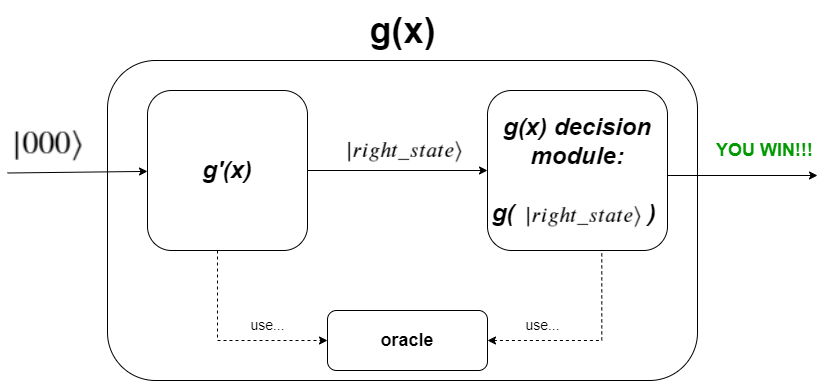

In [3]:
from PIL import Image
img = Image.open(r'C:/Users/54299/Desktop/Facultad/4to anio/Cursos/Escuela de Computacion Cuantica en Español 2023/modelo cuantico.png')
display(img)

Although the theoretical idea of this architecture sounds very promising, for implementing it we must create $g'(x)$ in a way that guarantees (or at least has a high probability) obtaining $| status\_correct\rangle$.

## 3. Reducing the Monty Hall problem to Lazy Colleague problem

After some research, we found the Lazy Colleague problem, which mathematical formulation it preety similar to the Monty Hall problem formulation. Also, we found an optimal quantum algorithm that solves the Lazy Colleague problem with a success probability of 90% or more.

Lets formulate the problem:

It is very common to wotk in teams, but it is just as common to find a teammate who decides not to work. However, colleagues do not usually tell the boss, so this individual goes unnoticed. Zenda is supervising three employees, and it is known that one of them never works. But who is it?

The project Zenda's team is working on can only be completed if at least two people in the team are working. This could be represent the same way the choosen doors states are represented, using string like $001, 010, 100$.

Despite our problem is setted up with 4 qubits(teammates or doors), we will program the general version for $n$ qubits (teammates or doors).

The algorithm to solve this problem is a Grover's search algorithm with some variations introduced:

* First of all, instead of preparing the state using a barrier of H gates, we will use a state preparator that create a $W$ state for three qubits. That is, an equal superposition between $| 100 \rangle,| 010 \rangle$ and $| 001 \rangle$. This module will be call $W$.

DECOMPOSED W CIRCUIT:


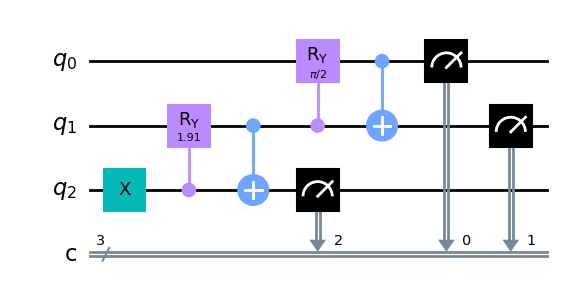

-------------------------------------------------------------------------------------------------------------------
MEASUREMENT RESULTS:


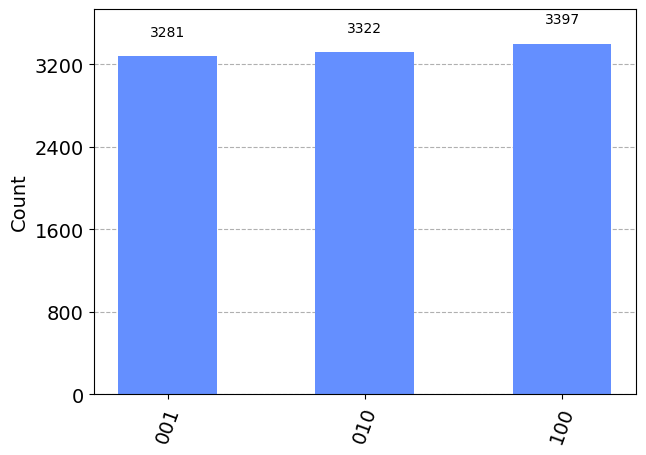

In [15]:
from qiskit import QuantumCircuit,QuantumRegister,ClassicalRegister,execute
from qiskit_aer import Aer
from qiskit.visualization import plot_histogram
import numpy as np

def w_cir(n):
    
    prob_amp = np.sqrt(1/n)
    rot_ang = 2*np.arccos(prob_amp)
    
    qc_w = QuantumCircuit(n,name="W state preparation") 
    qc_w.x(n-1)
    
    for i in range(n-2,-1,-1):
        comp_amp = np.sqrt((i+2)/n)
        rot_ang = 2*np.arccos(prob_amp/(comp_amp))
        qc_w.cry(rot_ang,i+1,i)
        qc_w.cx(i,i+1)
    
    return qc_w

n=3
qc = QuantumCircuit(n,n)
qc.append(w_cir(n),range(n))
qc.measure(range(n),range(n))

localSimulator = Aer.get_backend('qasm_simulator')
result = execute(qc, localSimulator, shots=10000).result()
counts = result.get_counts(qc)
print('DECOMPOSED W CIRCUIT:')
display(qc.decompose().draw('mpl'))
print('-------------------------------------------------------------------------------------------------------------------')
print('MEASUREMENT RESULTS:')
display(plot_histogram(counts))

* For our oracle, we will the same definition

ORACLE THAT MARK 010 STATE:


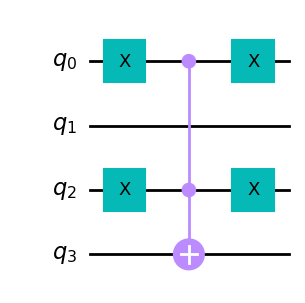

In [16]:
from qiskit.circuit.library import XGate
from qiskit.quantum_info import Statevector

def oracle(n,marked_state):
    
    # create the oracle state marker (a multi control X gate)
    mcx = XGate().control(n-1)
    
    #no marked states list, where it will be applied X gate. These will be the control states of the state marker(the multi control X gate).
    no_marked_states = []
    
    qc = QuantumCircuit(n+1,name="Oracle")
    
    #An X gate is applied to each no marked state
    for i in range(n):
        if i != marked_state:
            qc.x(i)
            no_marked_states.append(i)
    
    # create an list with the qubits that will be use in the multi control X gate. Ther the no marked states + ancilla
    mcx_qubits = no_marked_states.copy()
    mcx_qubits.append(n)
    
    # multi control X gate
    qc.append(mcx,mcx_qubits)
    
    # for each no marked state we apply an X gate again
    for i in no_marked_states:
        qc.x(i)
    
    return qc

qc=oracle(3,1)
print('ORACLE THAT MARK 010 STATE:')
display(qc.draw('mpl'))

* Our diffuser, instead of using $H^\dagger$ and $H$ to the uncomputing process, it will use $W^\dagger$ and $W$.

DIFFUSER:


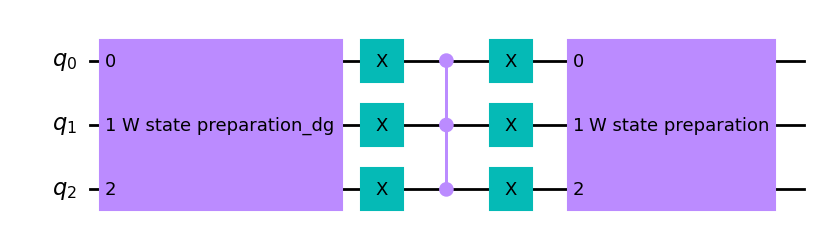

In [17]:
from qiskit.circuit.library import ZGate

def diffuser(n):
    
    mcz = ZGate().control(n-1)
    qc = QuantumCircuit(n,name="diffuser")
    
    qc.append(w_cir(n).inverse(),range(n))
    
    for i in range(n):
        qc.x(i)
    qc.append(mcz,range(n))
    for i in range(n):
        qc.x(i)
    
    qc.append(w_cir(n),range(n))
    
    return qc

qc=diffuser(3)
print('DIFFUSER:')
display(qc.draw('mpl'))

The grover's search works a variable number of iterations of oracle + diffuser. The number of iterations is given by $r = \frac{\pi}{4} \frac{1}{arcsin(\sqrt{\frac{1}{n}})} - \frac{1}{2}$, where $n =$ number of states to compare. In our case, with three qubits in a $W$ state, we have $n=3$. It is important to notice that when $r \notin Z$, there is no amount of repetitions that could guarantee a $100\%$ of success probability. The good news are that, although that, the success probability in that cases will be greater than $92\%$. In other cases, like for $n=4$, $r=1$ and the algorithm will guarantee finding the correct answer.

Finally, we are able to create the complete algorithm that could solve Lazy Colleague problem, and thanks to that, the Monty Hall Problem. From now on, we will come back to talk in terms of Monty Hall problem (like talking about doors, participant decitions, goats, etc...) to analyze the results of the algorithm.


r =  0.776074828029885
amount of iterations for oracle + diffuser: 1

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


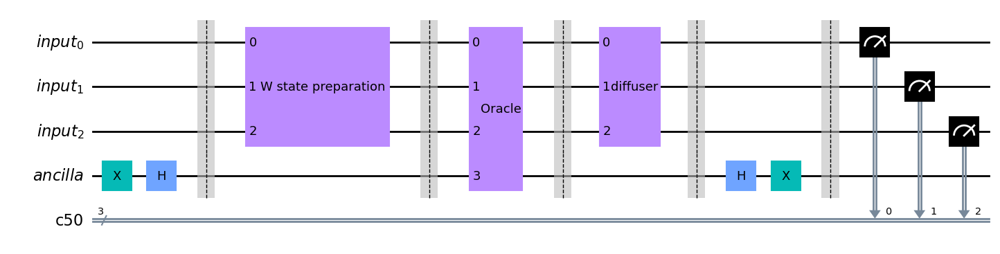


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


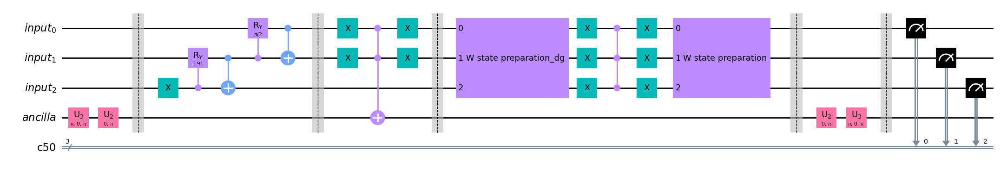


-------------------------------------------------------------------------------------------------------------------

RESULTS:


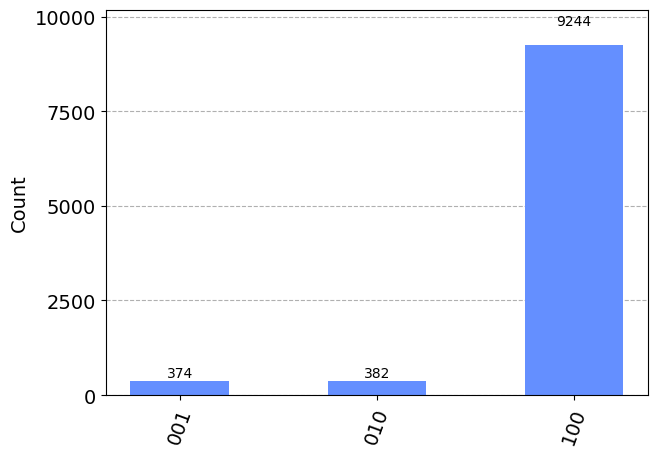

In [18]:
from numpy import pi,arcsin,sqrt

#PLEASE CHANGE N AND MARKED STATE TO EXPERIMENT WITH DIFFERENT COMBINATIONS FOR THE PROBLEM
#MARKED STATE SHOULD BE THE VALUE WHERE THE CORRECT DOOR WILL BE PLACED
#FOR EXAMPLE, IF THERE ARE 8 DOORS AND THE CORRECT DOOR IS THE 4TH ONE FROM RIGHT TO LEFT, MARKED_STATE=3
#AND REPRESENTS THE STRING 00001000
n=3
marked_state = 2

#iterations calculus
a = (pi/4) 
b = 1/arcsin(sqrt(1/(n)))
c=1/2
r = a * b - c
iterations_amount = round(a * b - c)


print()
print('r = ',r)
print('amount of iterations for oracle + diffuser:',iterations_amount)
print()
print('-------------------------------------------------------------------------------------------------------------------')
qr = QuantumRegister(n,name="input")
ancilla = QuantumRegister(1,name="ancilla")
qc = ClassicalRegister(n)
qc = QuantumCircuit(qr,ancilla,qc)

# state preparation |-> for the ancilla
qc.x(n)
qc.h(n)
qc.barrier()

# W state preparation
qc.append(w_cir(n),range(n))
qc.barrier()

for i in range(iterations_amount):
    # oracle
    qc.append(oracle(n,marked_state),range(n+1))
    qc.barrier()

    # diffuser
    qc.append(diffuser(n),range(n))
    qc.barrier()


qc.h(n)
qc.x(n)
qc.barrier()

qc.measure(range(n),range(n))


print('CIRCUIT:')
display(qc.draw('mpl'))
print()
print('-------------------------------------------------------------------------------------------------------------------')
print()
print('DECOMPOSED CIRCUIT:')
display(qc.decompose().draw('mpl',fold=50))
print()
print('-------------------------------------------------------------------------------------------------------------------')
print()

print('RESULTS:')
localSimulator = Aer.get_backend('qasm_simulator')
result = execute(qc, localSimulator, shots=10000).result()
counts = result.get_counts(qc)
display(plot_histogram(counts))

## 4. Maximizing the success probability

After solving the problem with the common configuration of three doors, we ask ourselves what about solving the Monty Hall problem for $n$ doors. We decide to run this algorithm varying the amount of doors and compare the results.

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 3 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  0.776074828029885
amount of iterations for oracle + diffuser: 1

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


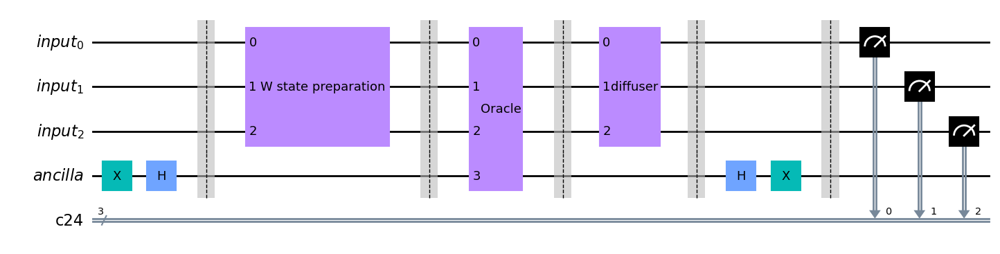


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


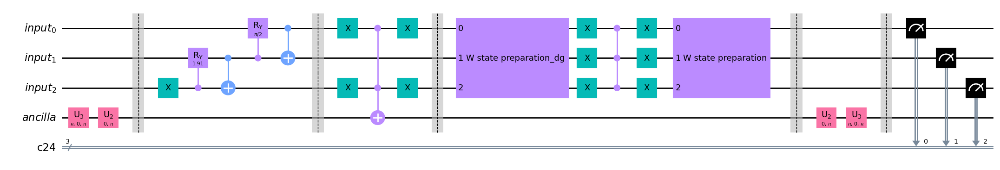


-------------------------------------------------------------------------------------------------------------------

RESULTS:


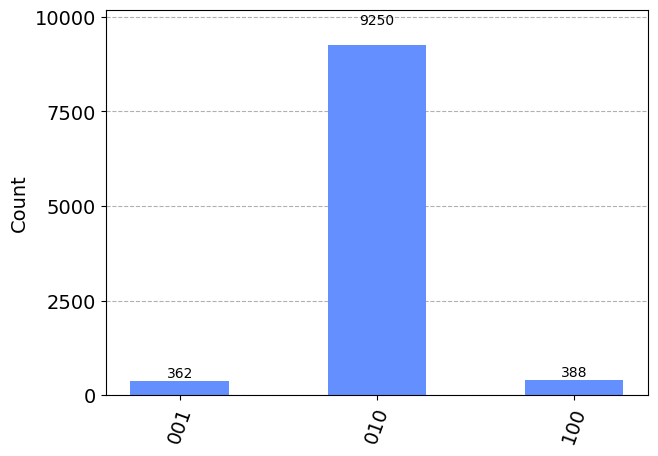

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 4 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  0.9999999999999998
amount of iterations for oracle + diffuser: 1

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


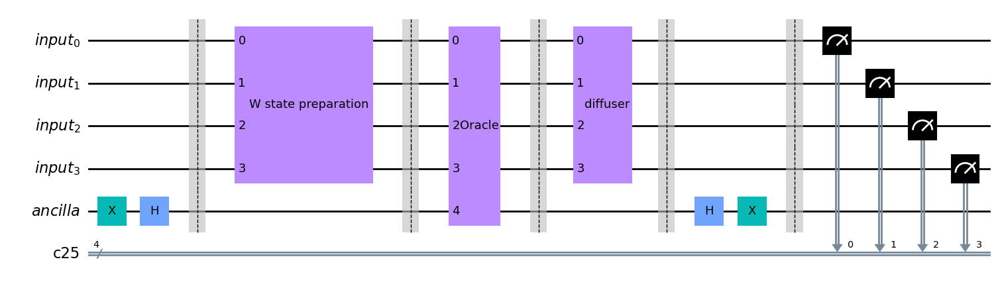


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


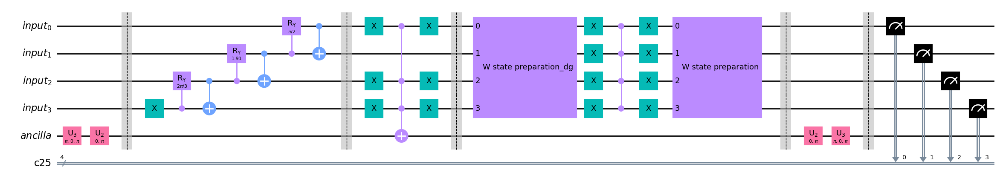


-------------------------------------------------------------------------------------------------------------------

RESULTS:


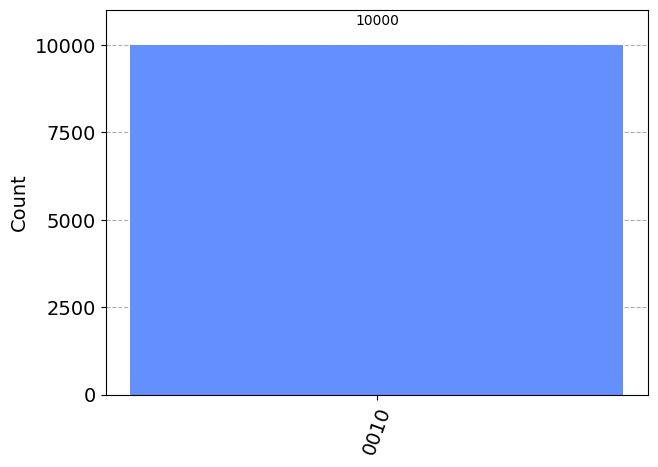

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 5 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  1.193954952318287
amount of iterations for oracle + diffuser: 1

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


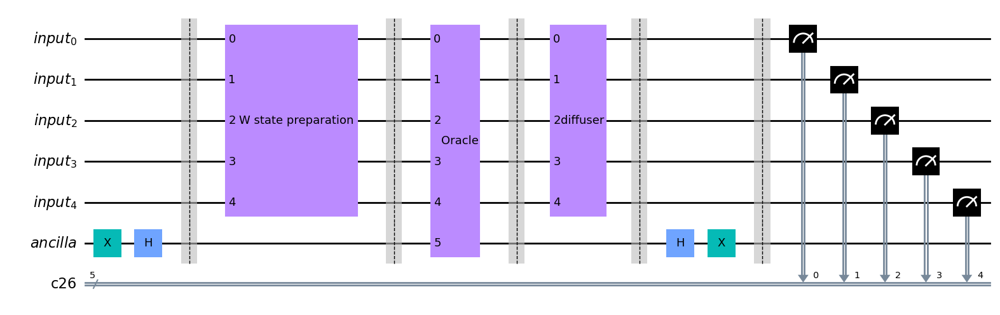


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


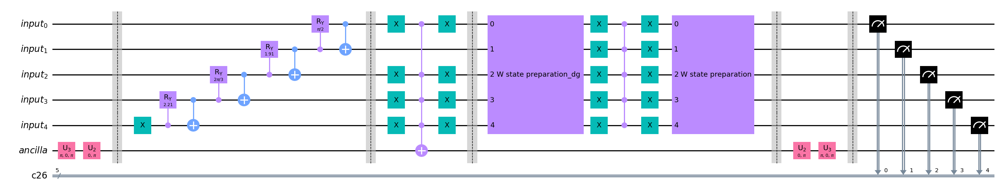


-------------------------------------------------------------------------------------------------------------------

RESULTS:


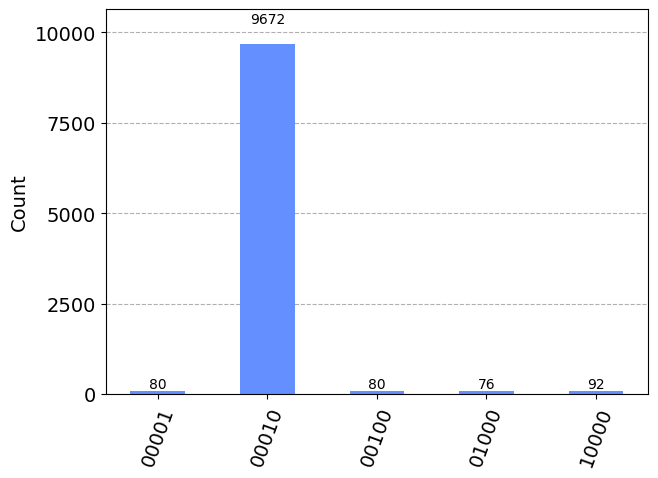

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 6 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  1.367619591316151
amount of iterations for oracle + diffuser: 1

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


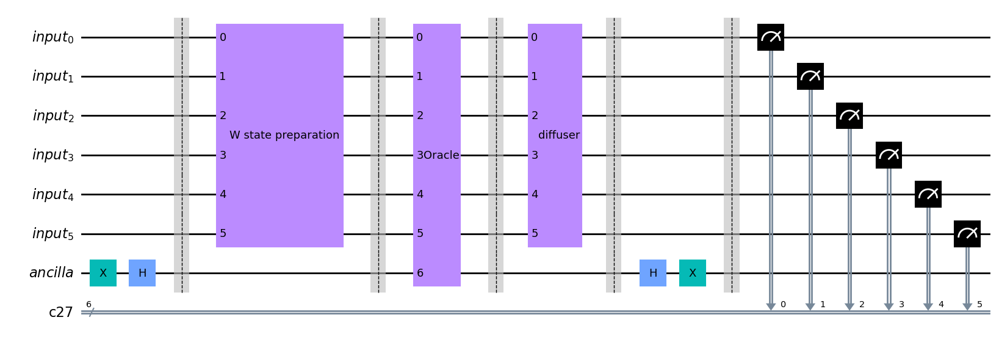


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


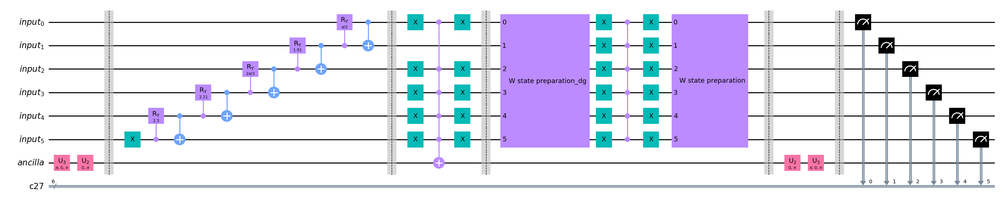


-------------------------------------------------------------------------------------------------------------------

RESULTS:


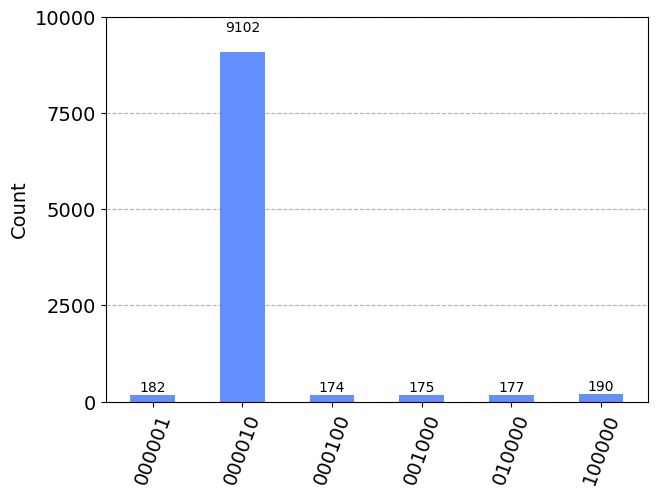

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 7 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  1.5263283728639445
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


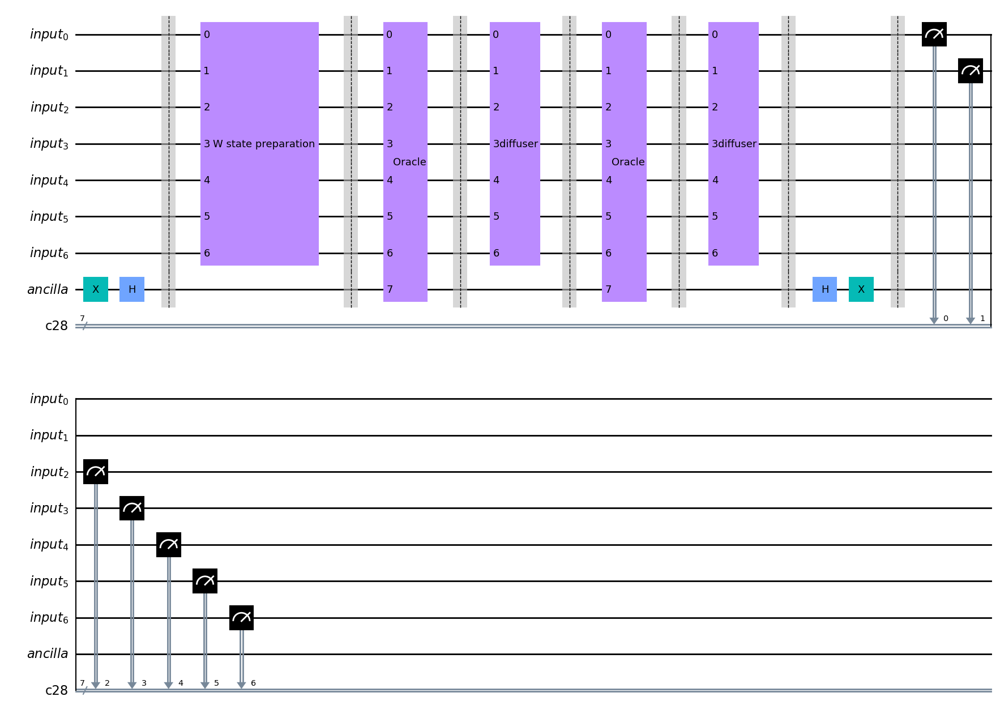


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


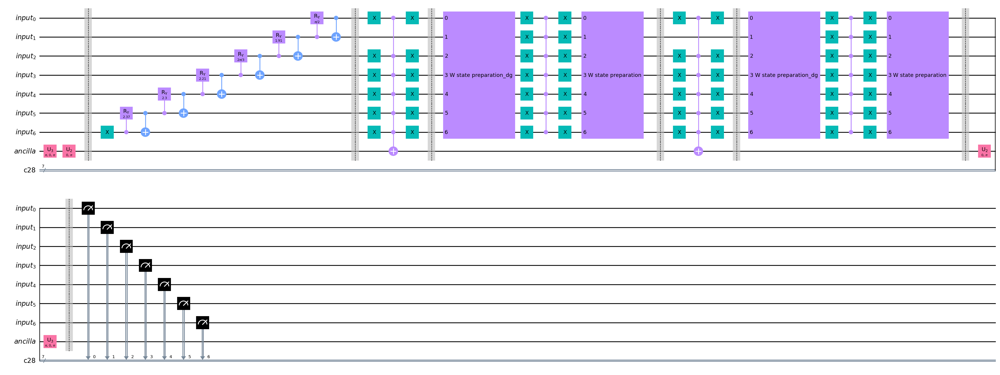


-------------------------------------------------------------------------------------------------------------------

RESULTS:


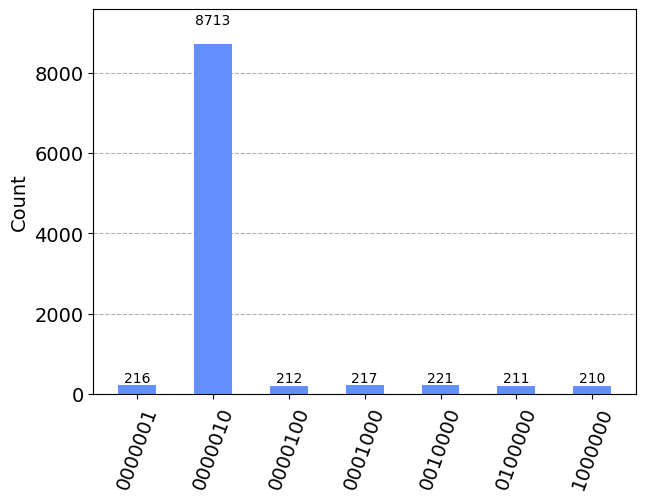

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 8 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  1.6734079041462837
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


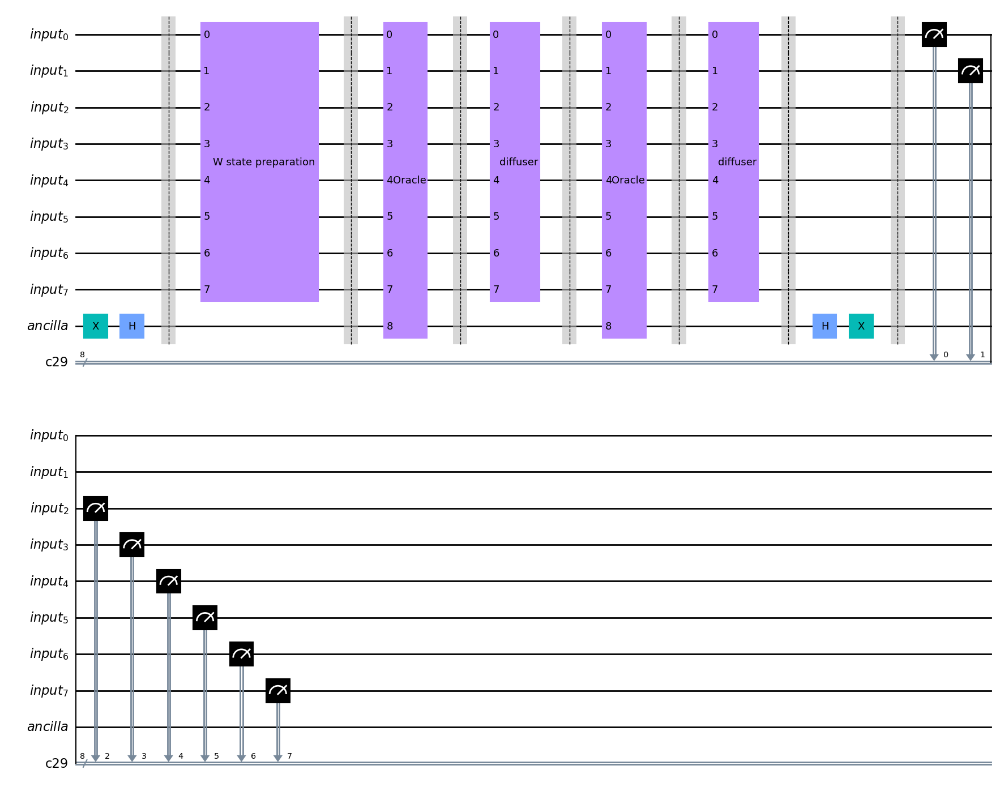


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


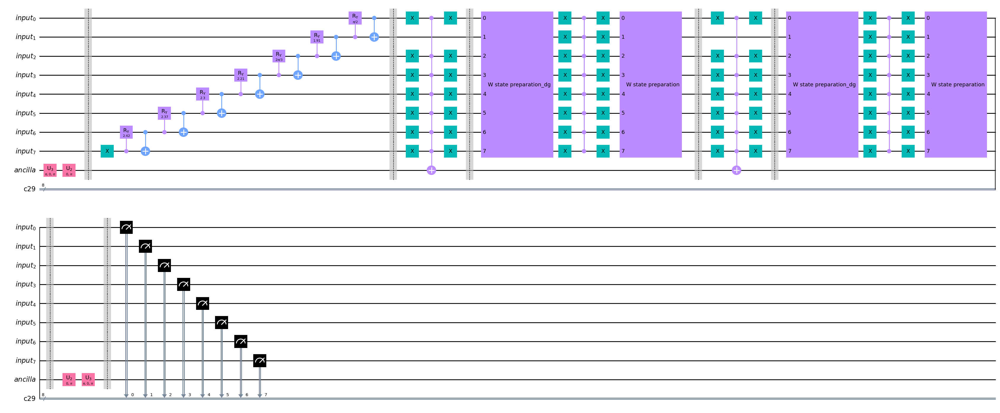


-------------------------------------------------------------------------------------------------------------------

RESULTS:


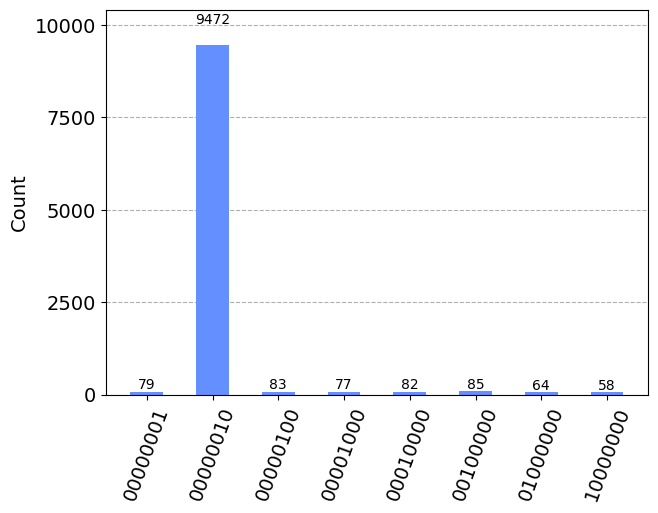

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 9 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  1.81110318375667
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


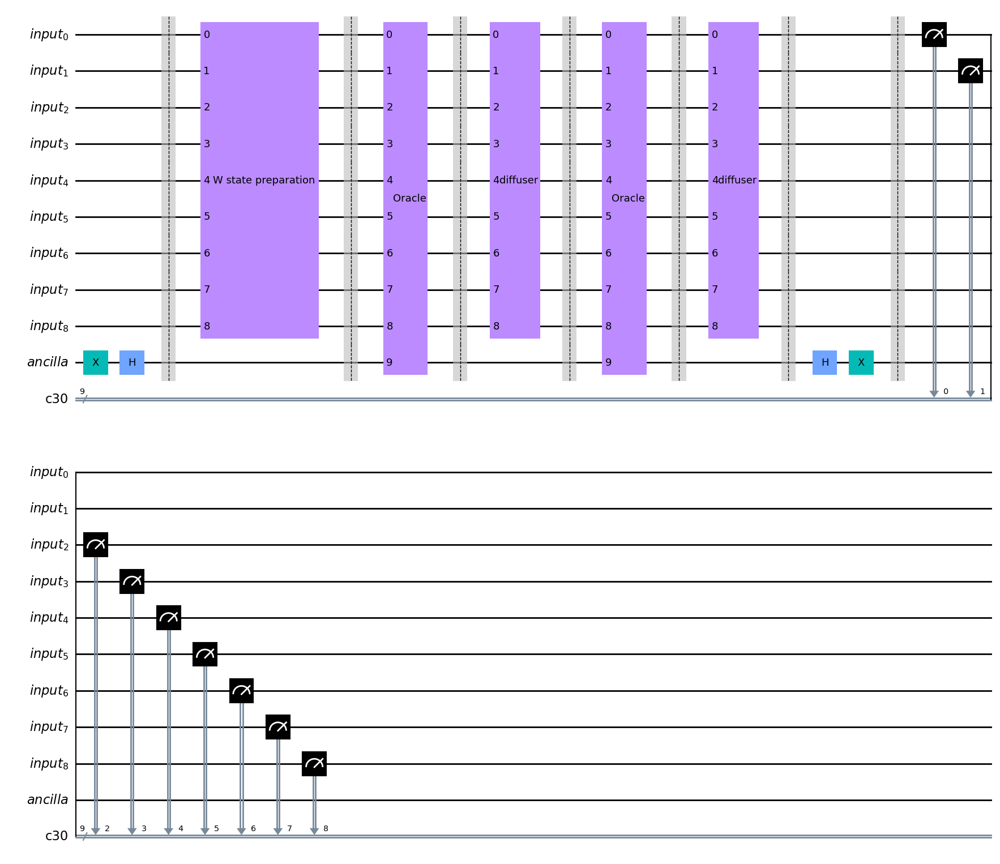


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


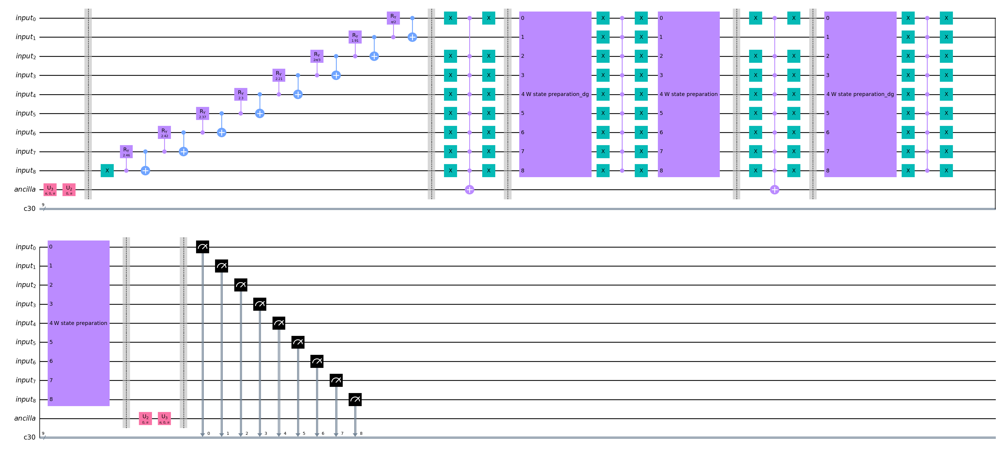


-------------------------------------------------------------------------------------------------------------------

RESULTS:


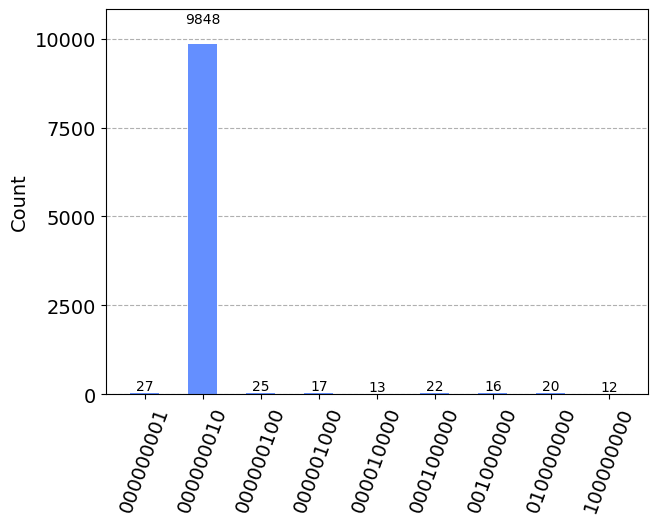

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 10 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  1.9410157268268091
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


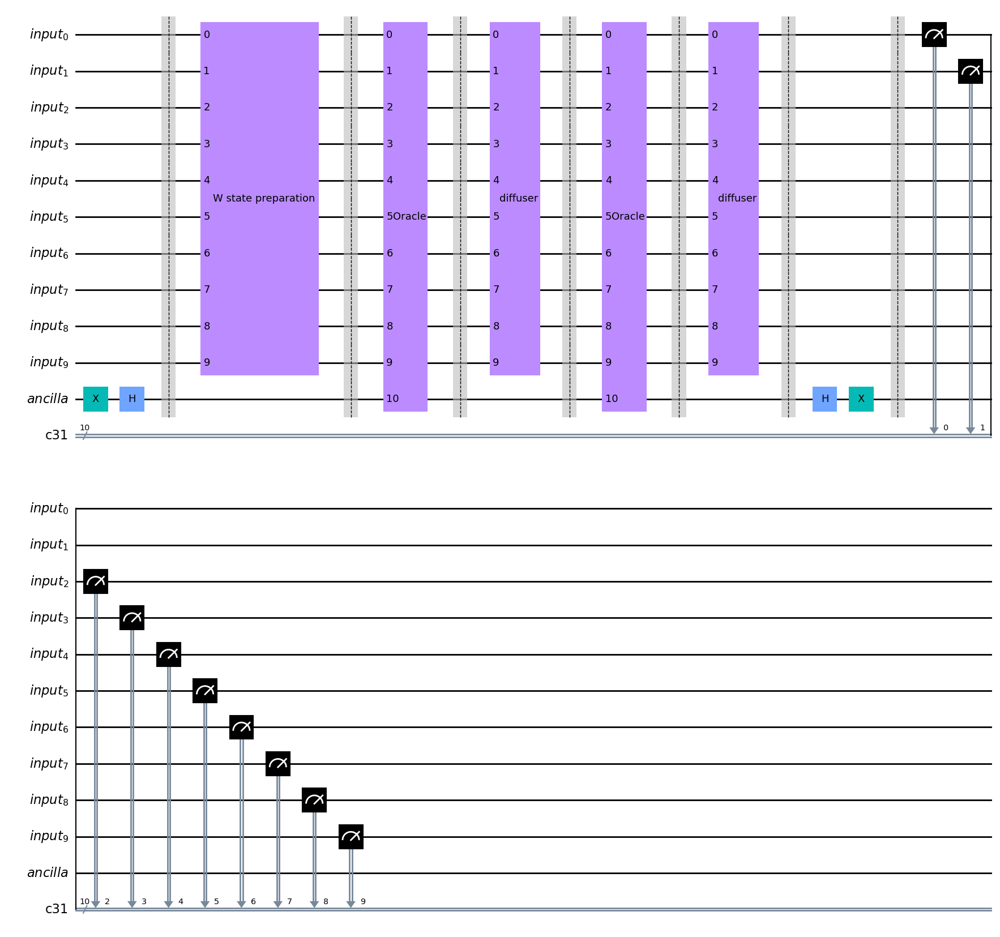


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


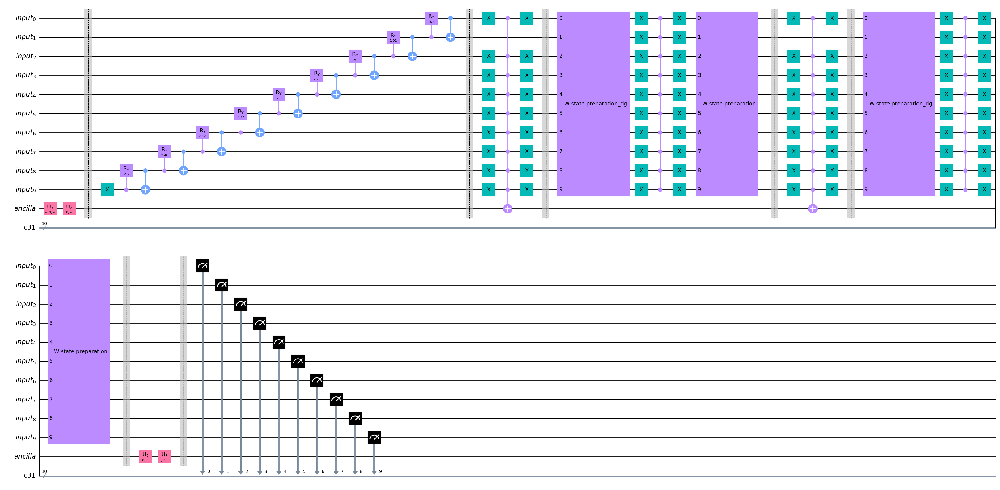


-------------------------------------------------------------------------------------------------------------------

RESULTS:


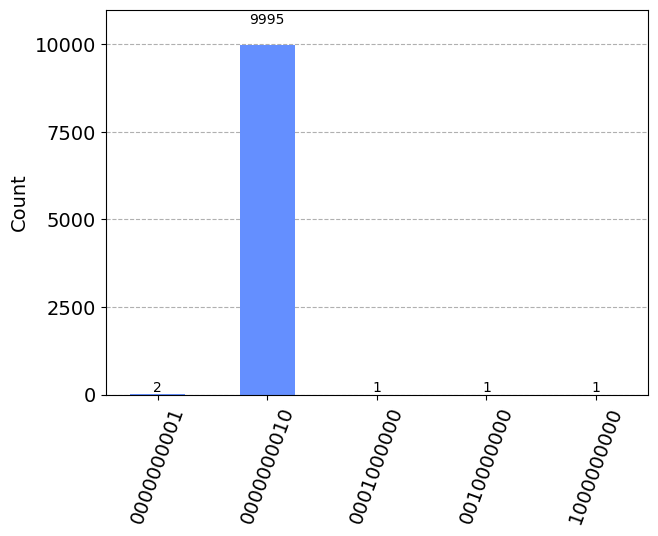

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 11 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  2.064336260059615
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


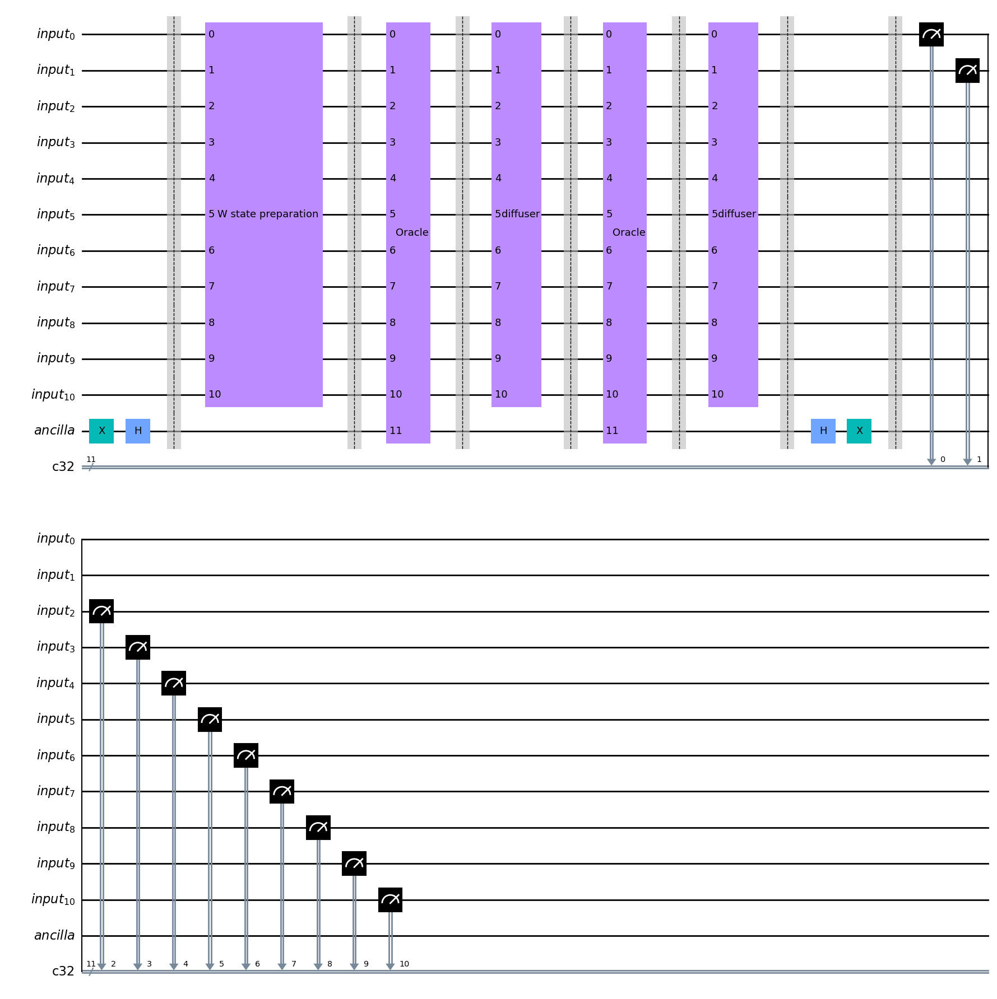


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


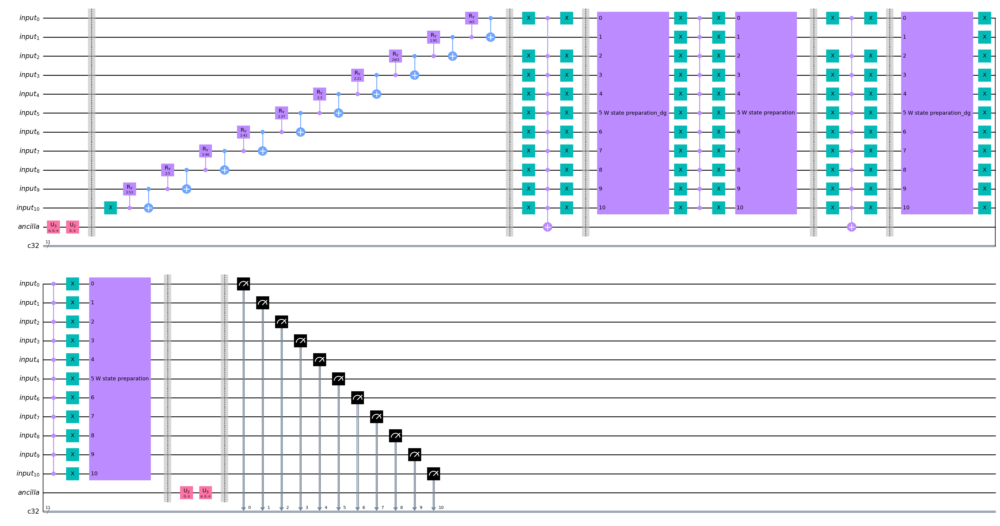


-------------------------------------------------------------------------------------------------------------------

RESULTS:


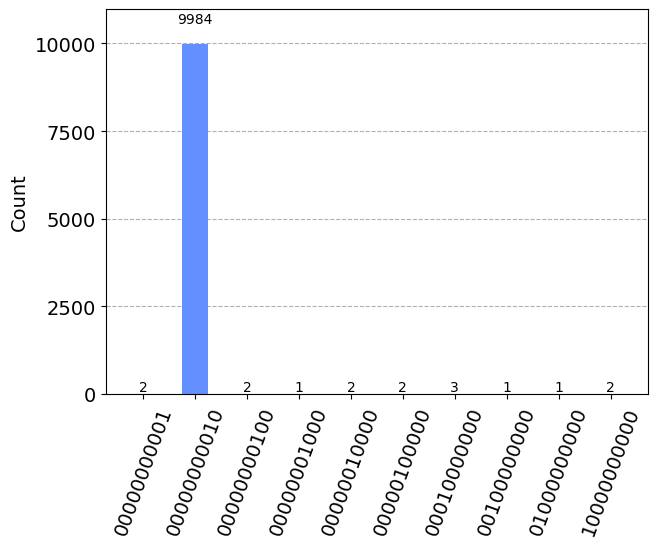

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 12 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  2.181978997676621
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


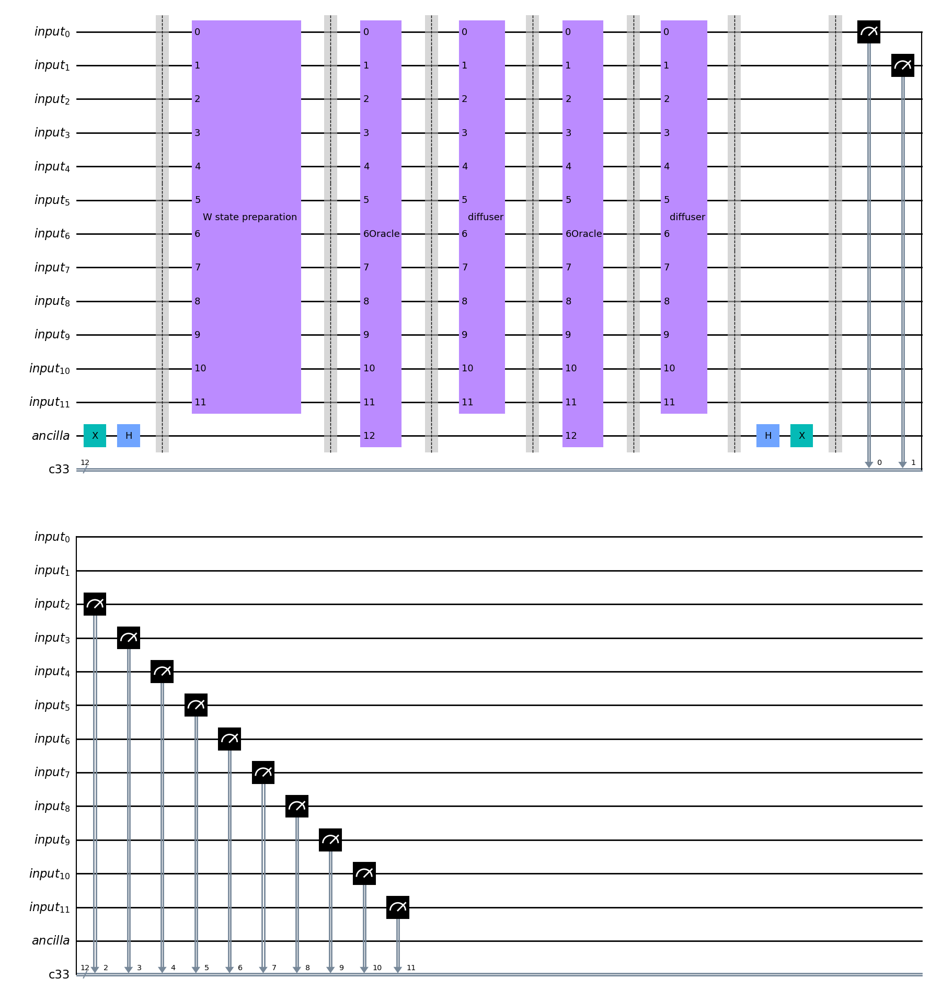


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


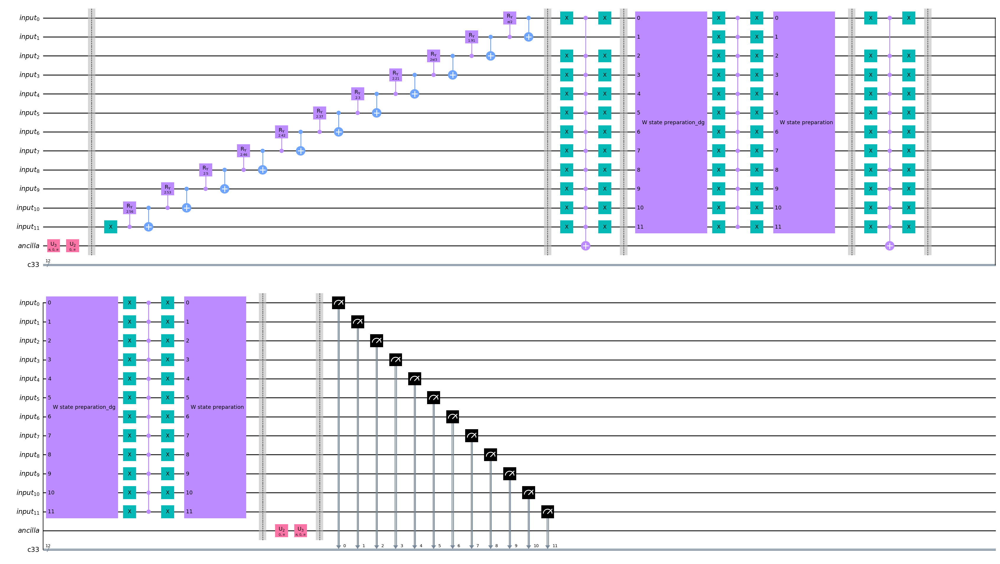


-------------------------------------------------------------------------------------------------------------------

RESULTS:


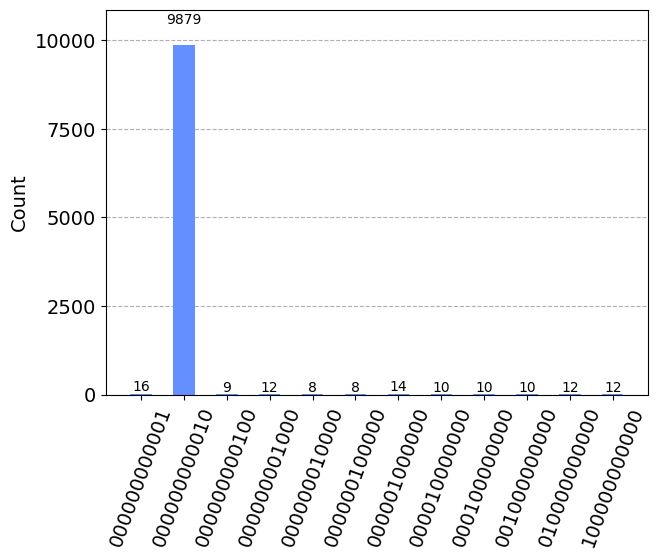

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 13 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  2.294664147398024
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


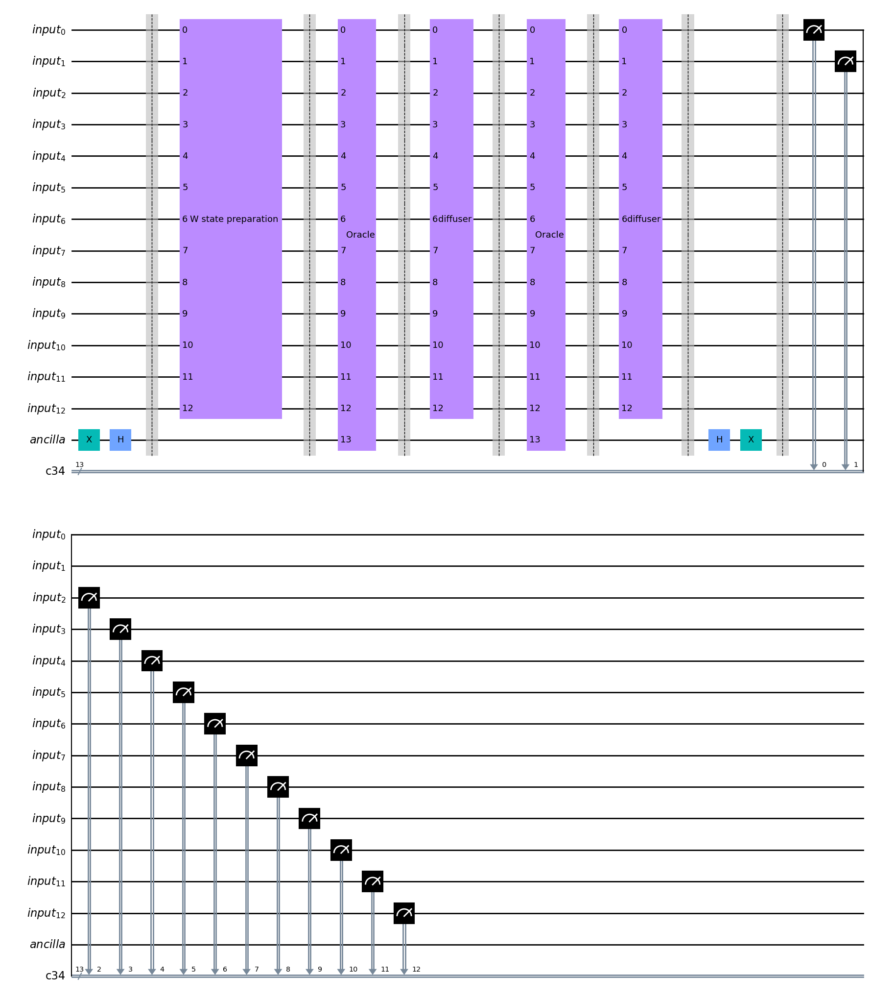


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


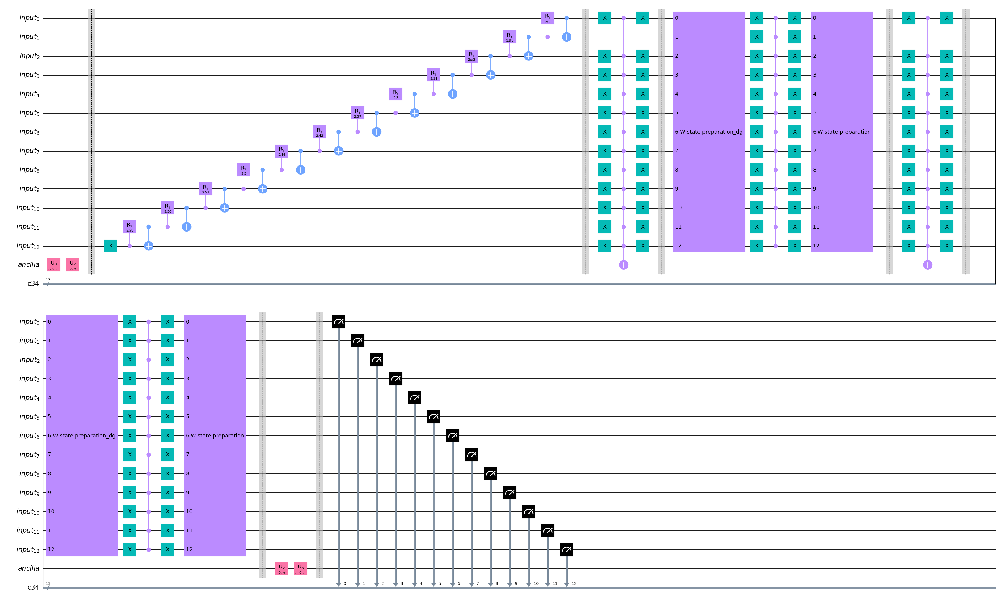


-------------------------------------------------------------------------------------------------------------------

RESULTS:


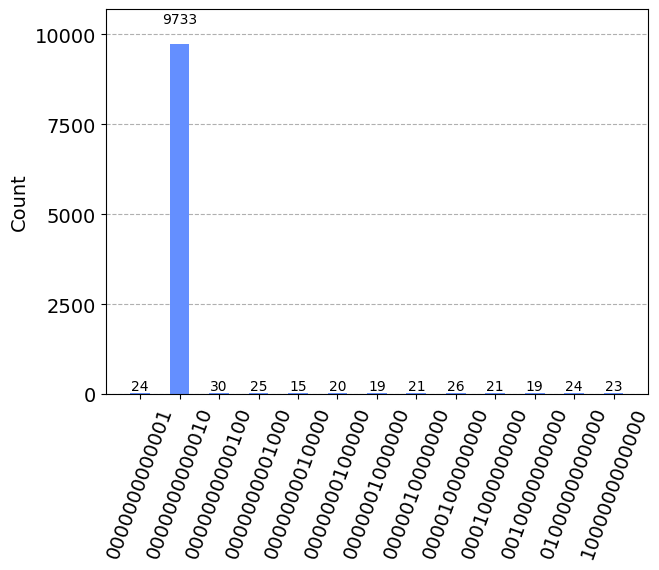

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 14 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  2.402971175249747
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


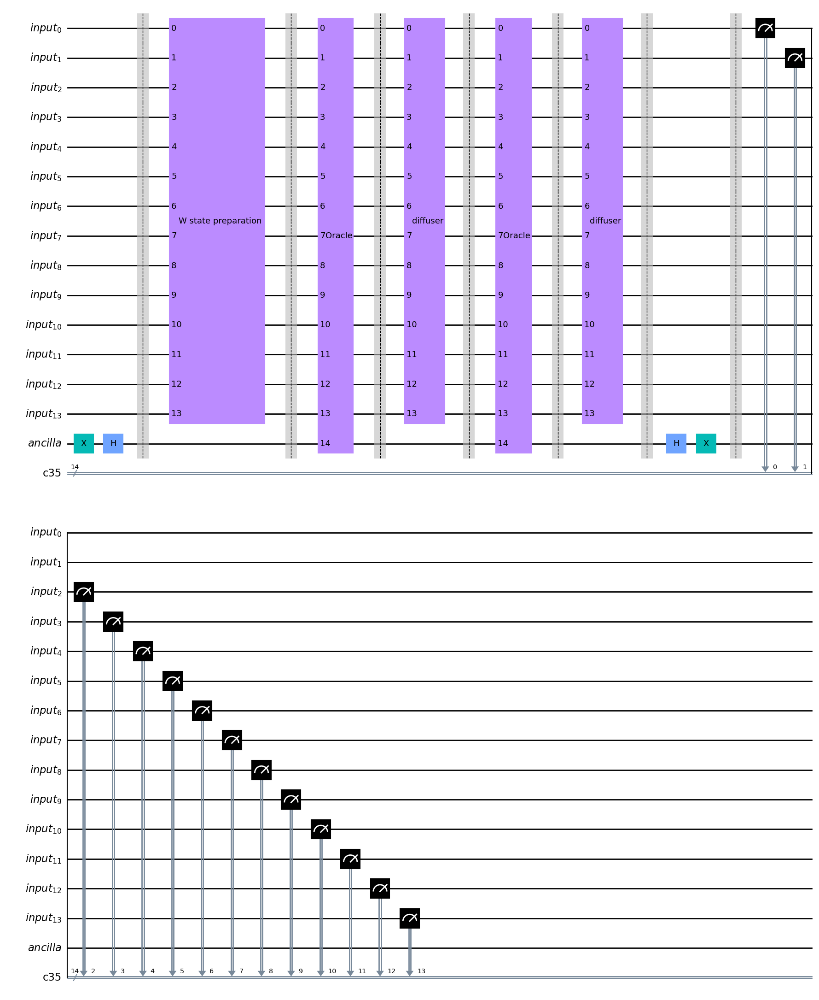


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


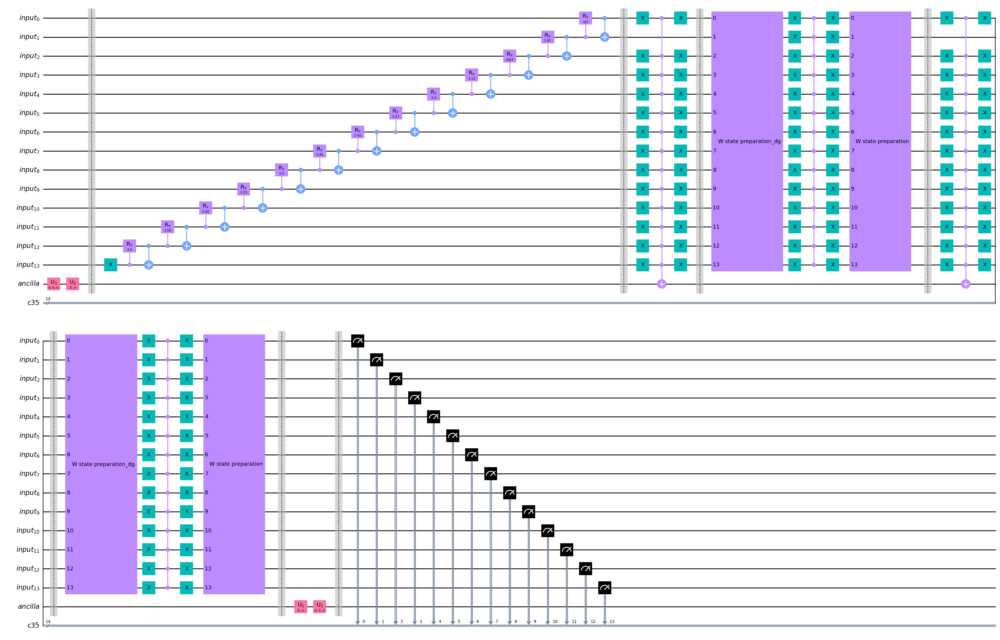


-------------------------------------------------------------------------------------------------------------------

RESULTS:


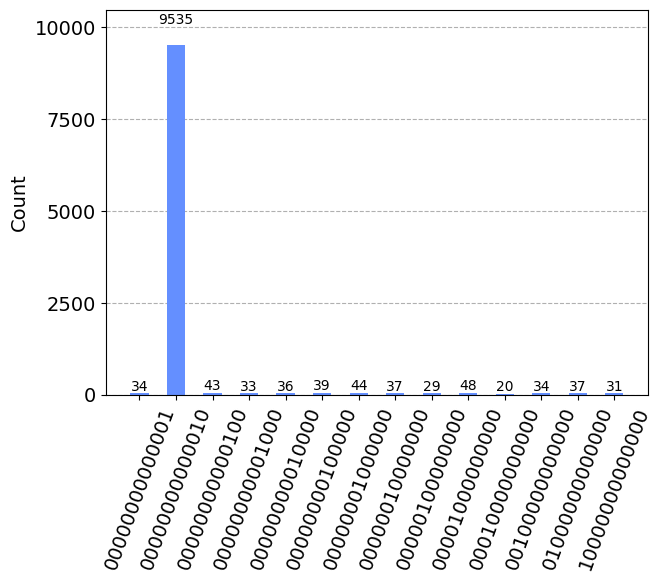

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 15 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  2.5073745971125843
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


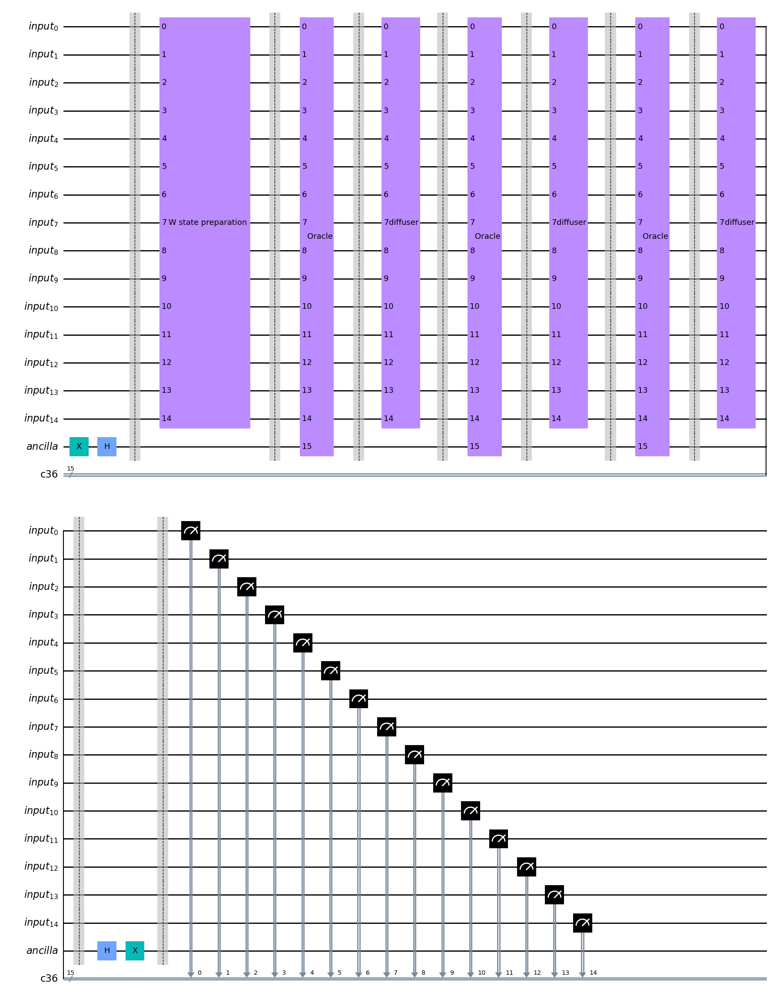


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


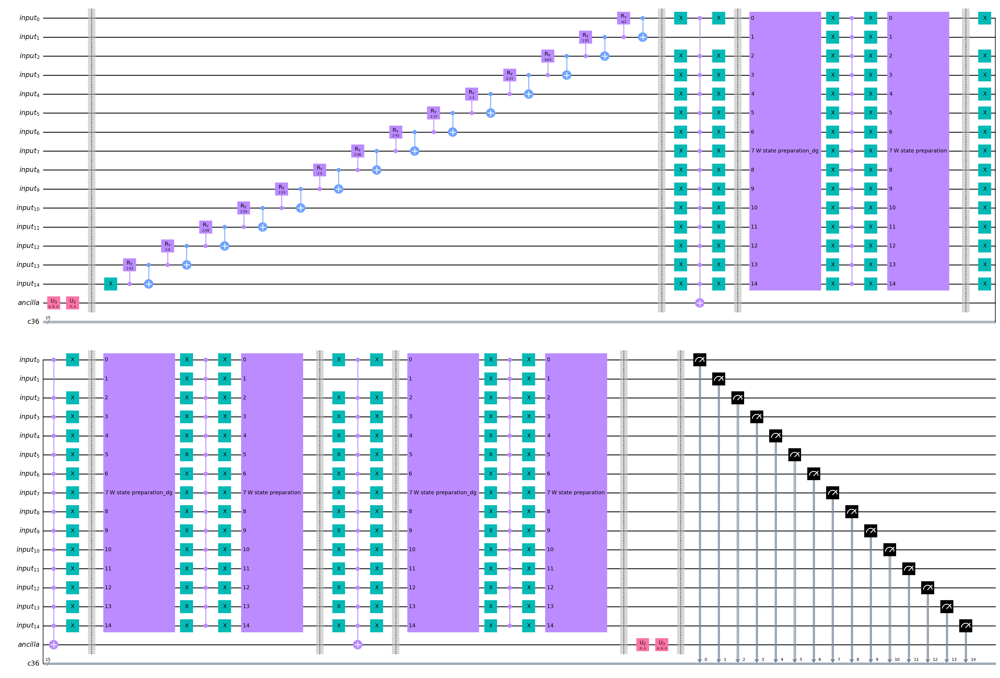


-------------------------------------------------------------------------------------------------------------------

RESULTS:


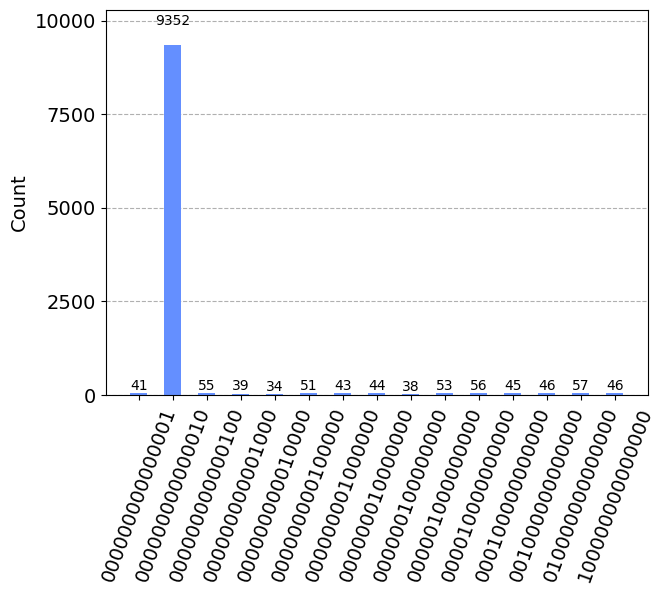

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 16 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  2.6082688394304085
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


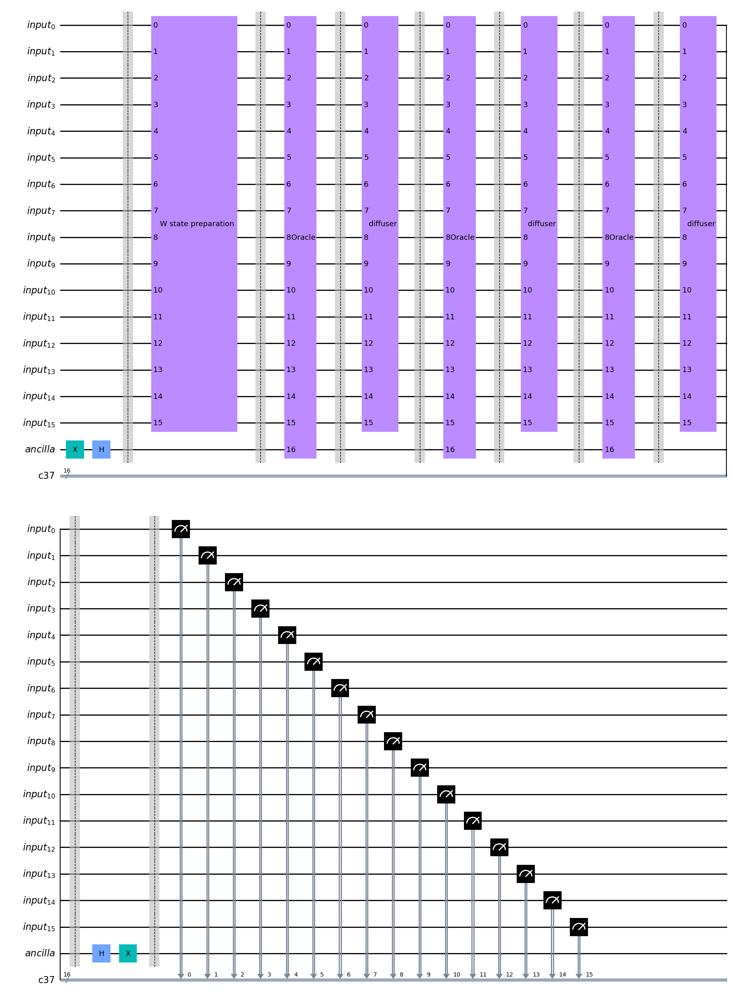


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


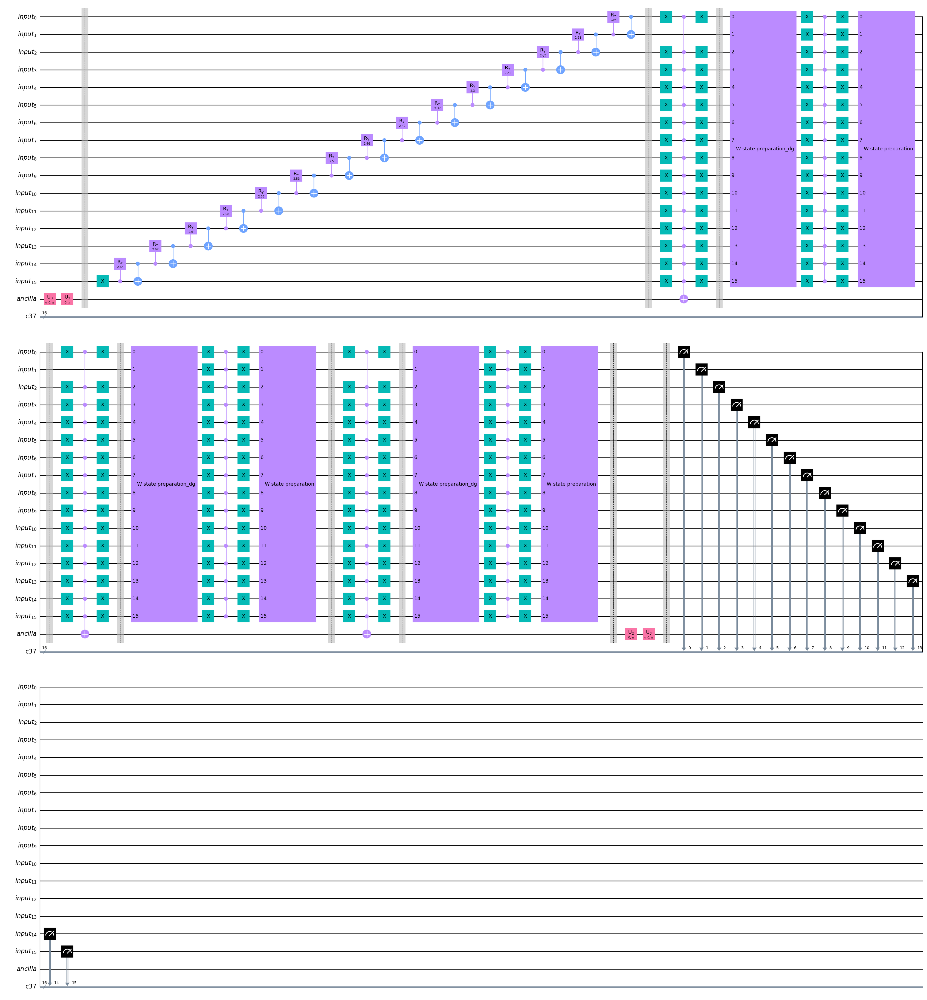


-------------------------------------------------------------------------------------------------------------------

RESULTS:


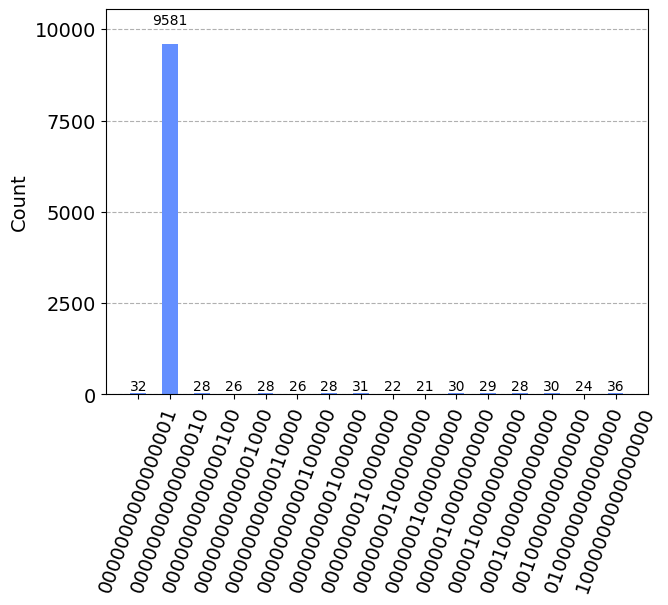

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 17 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  2.705985996383381
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


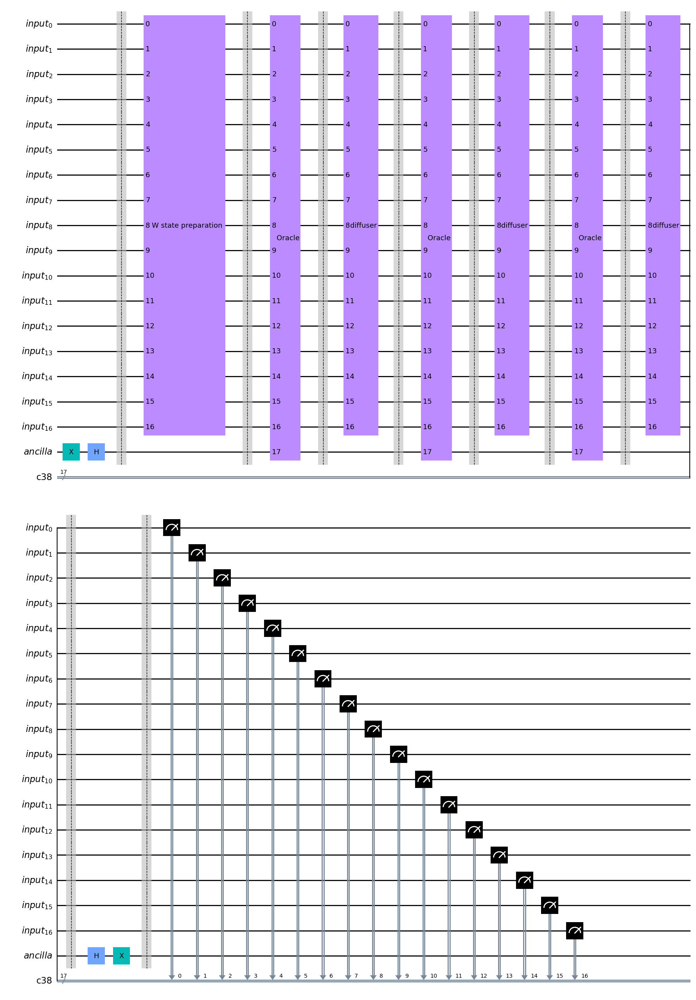


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


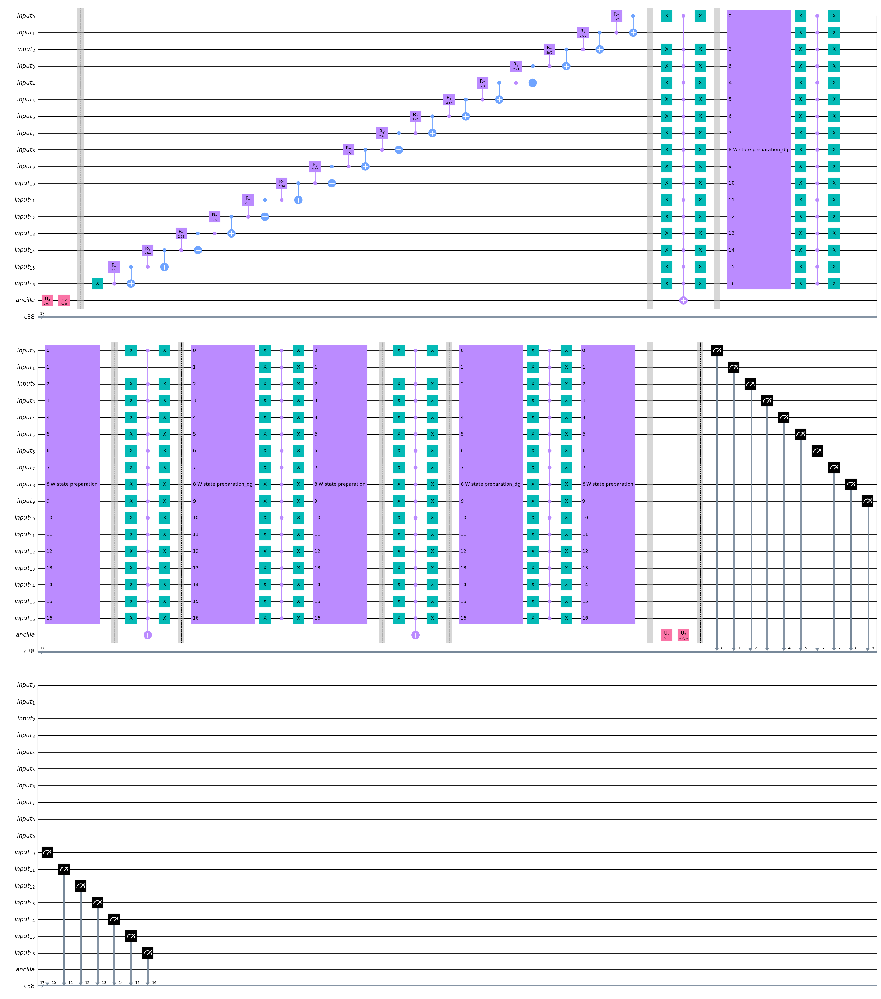


-------------------------------------------------------------------------------------------------------------------

RESULTS:


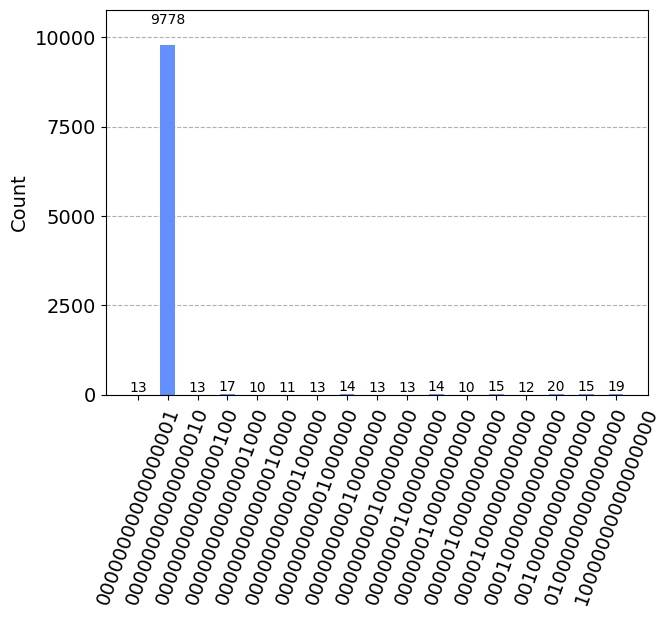

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 18 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  2.8008088196519134
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


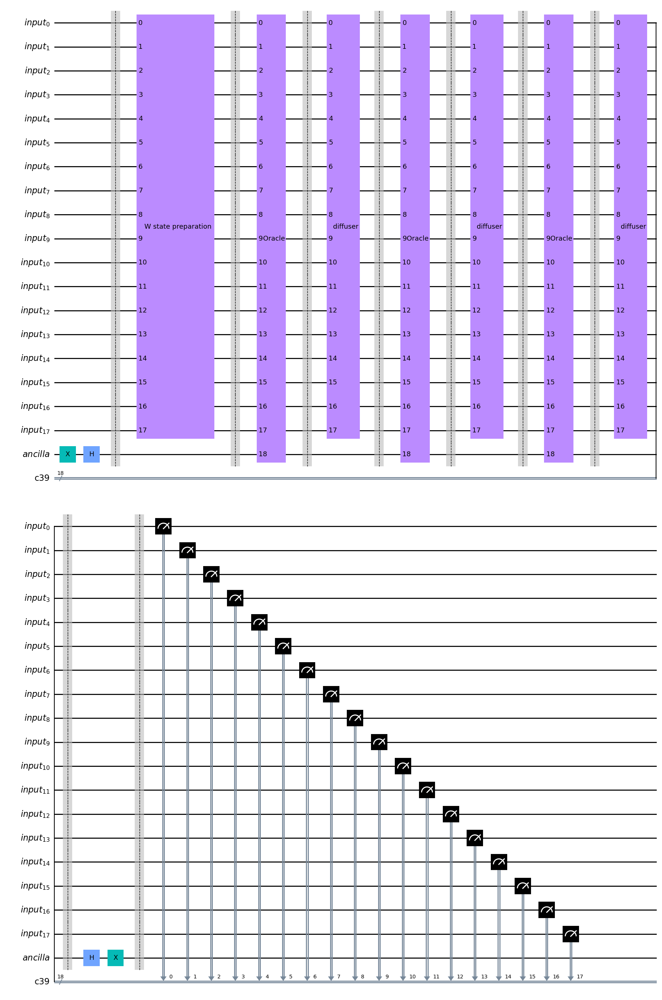


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


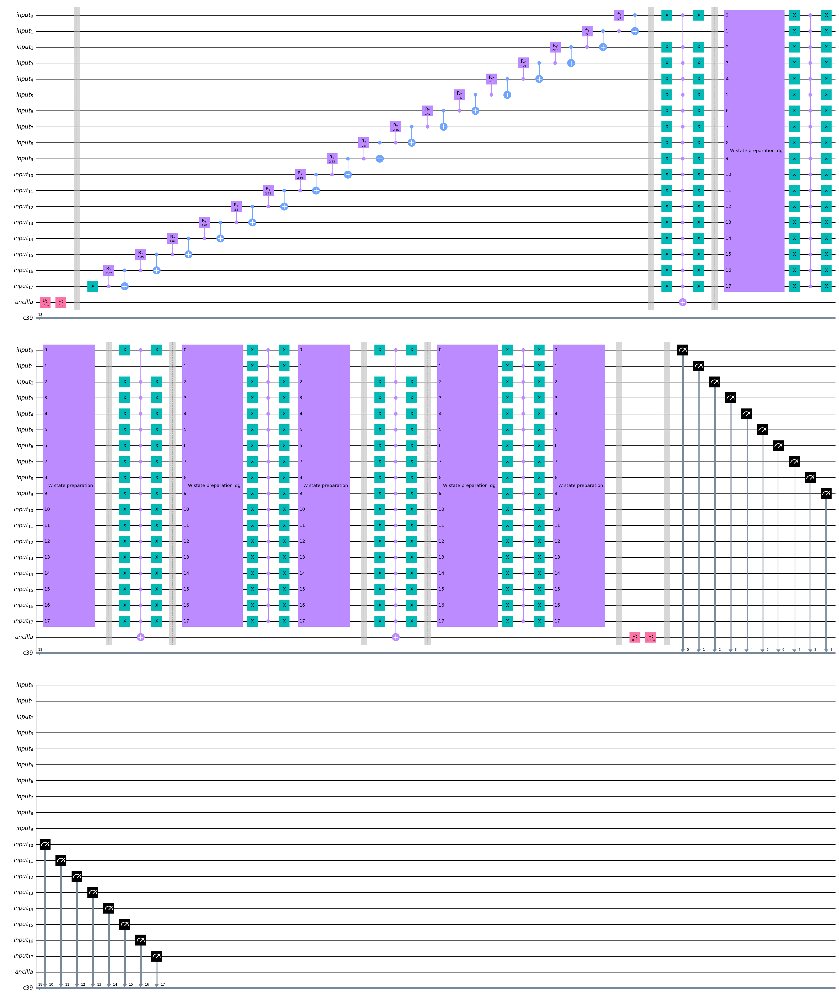


-------------------------------------------------------------------------------------------------------------------

RESULTS:


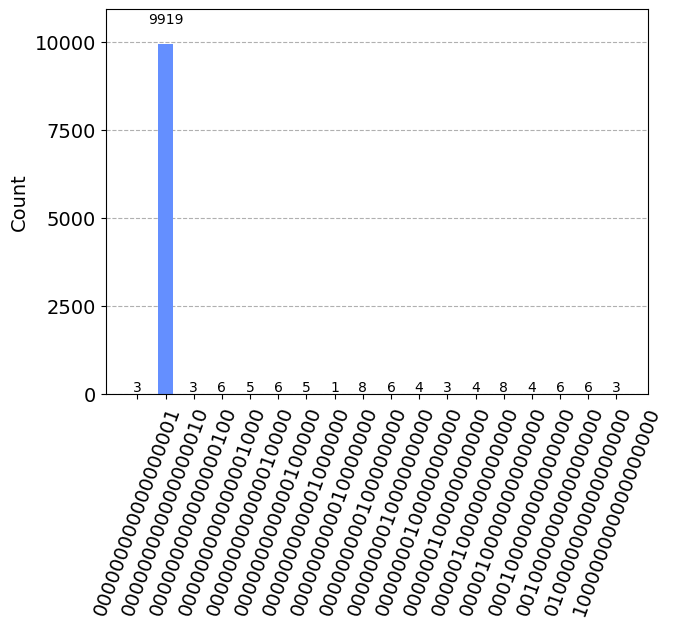

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 19 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  2.8929804190211548
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


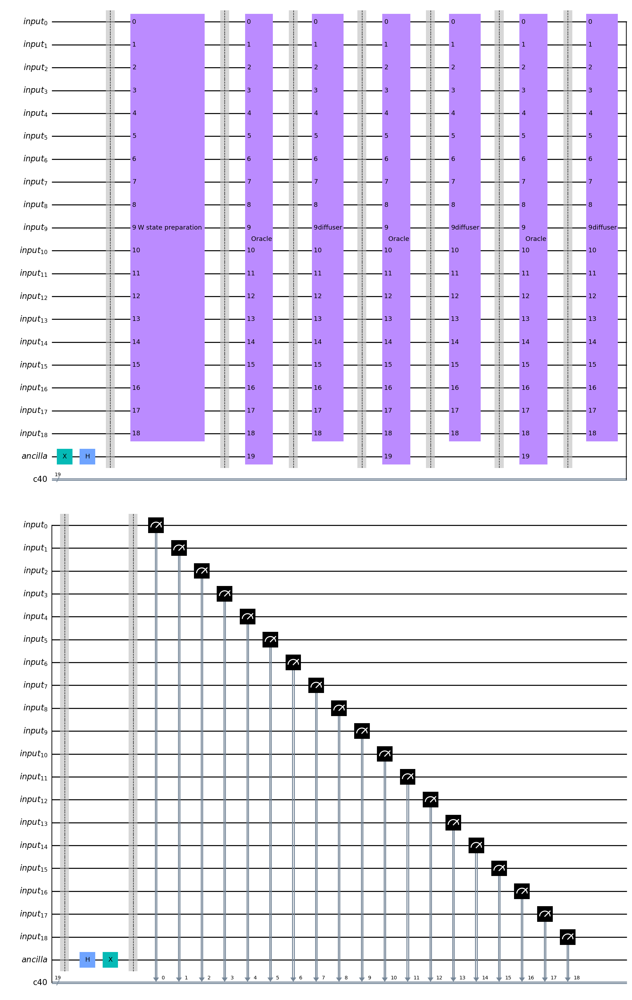


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


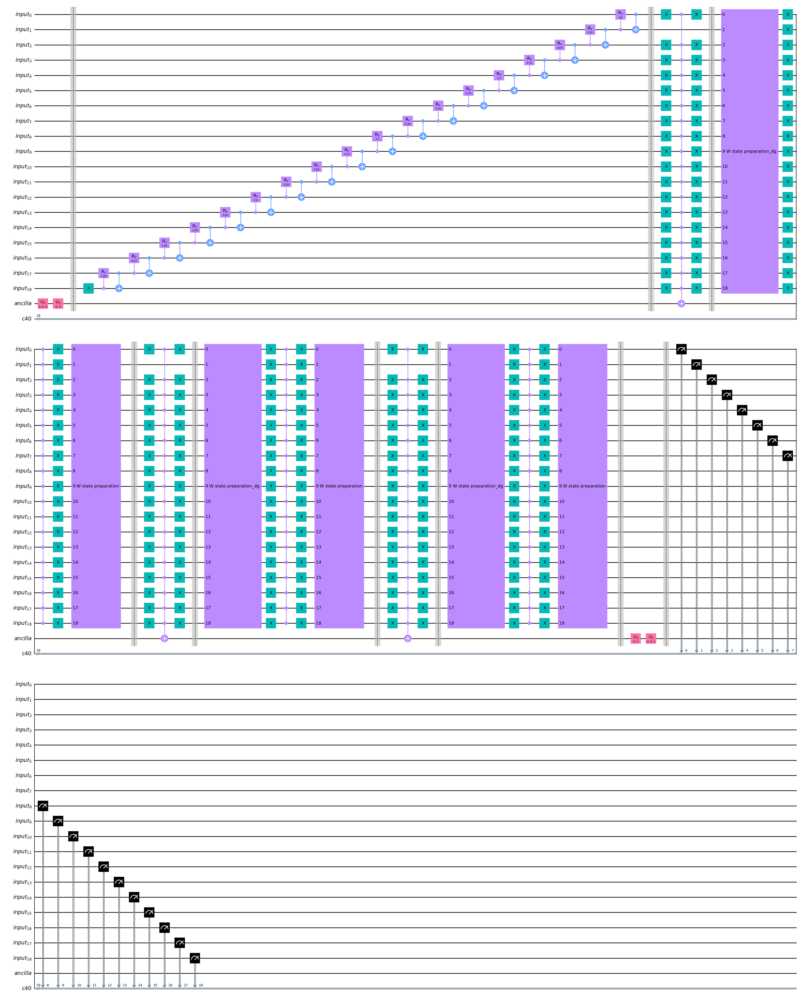


-------------------------------------------------------------------------------------------------------------------

RESULTS:


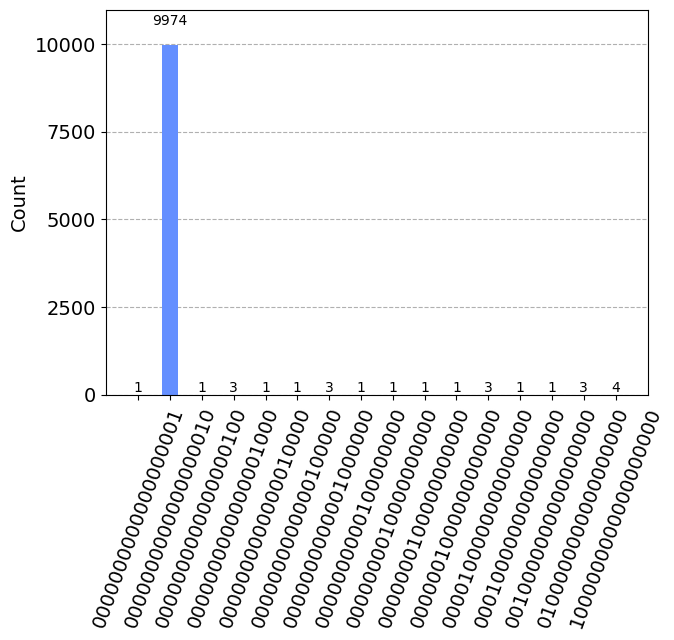

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 20 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  2.9827116386696226
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


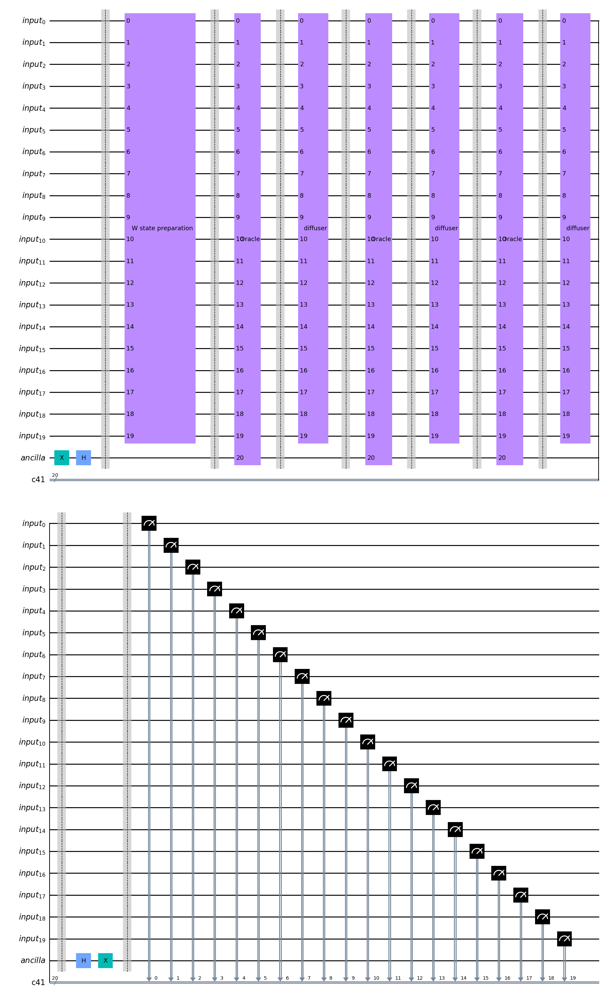


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


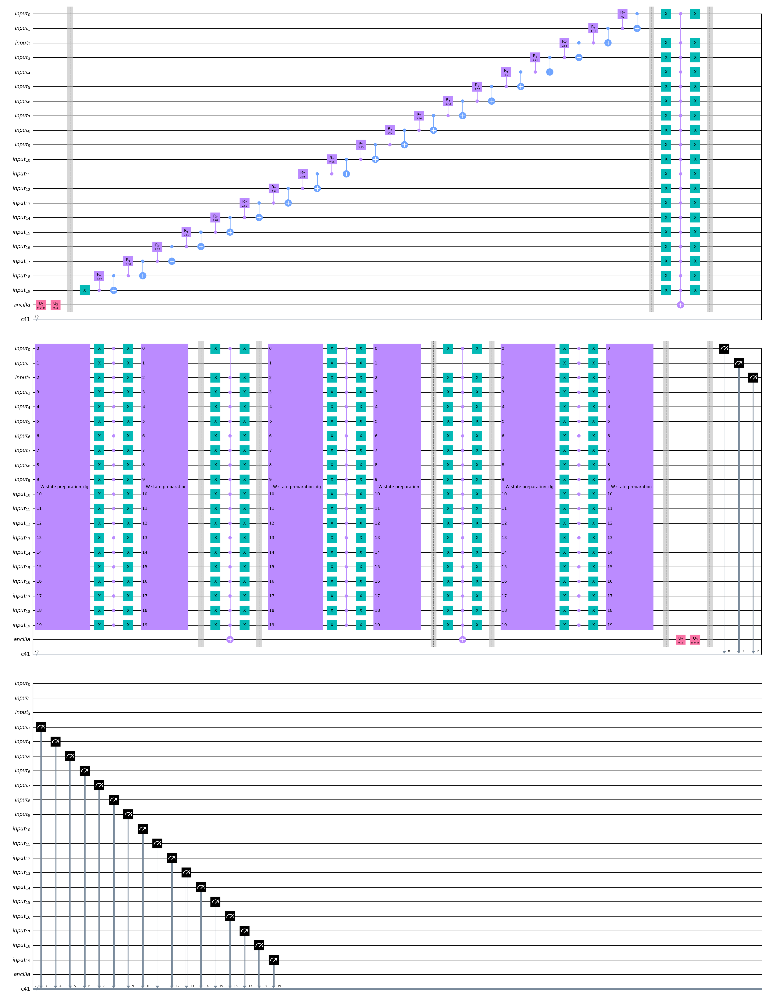


-------------------------------------------------------------------------------------------------------------------

RESULTS:


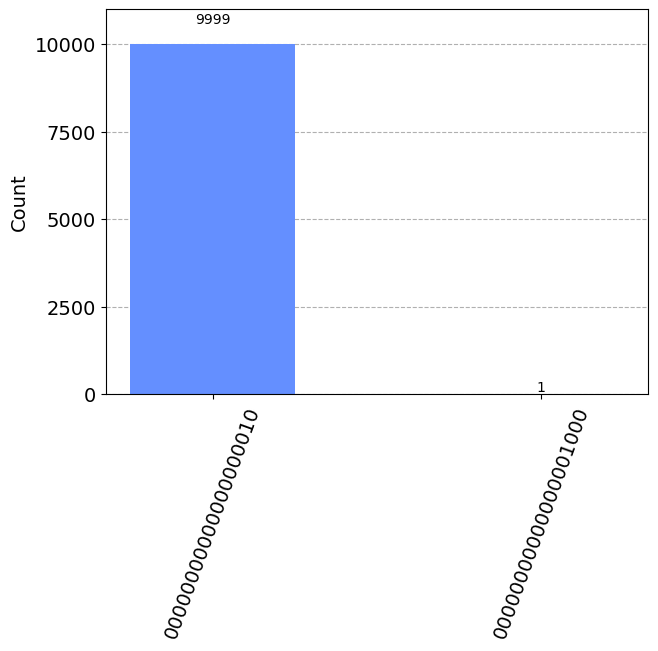

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 21 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  3.0701867560952403
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


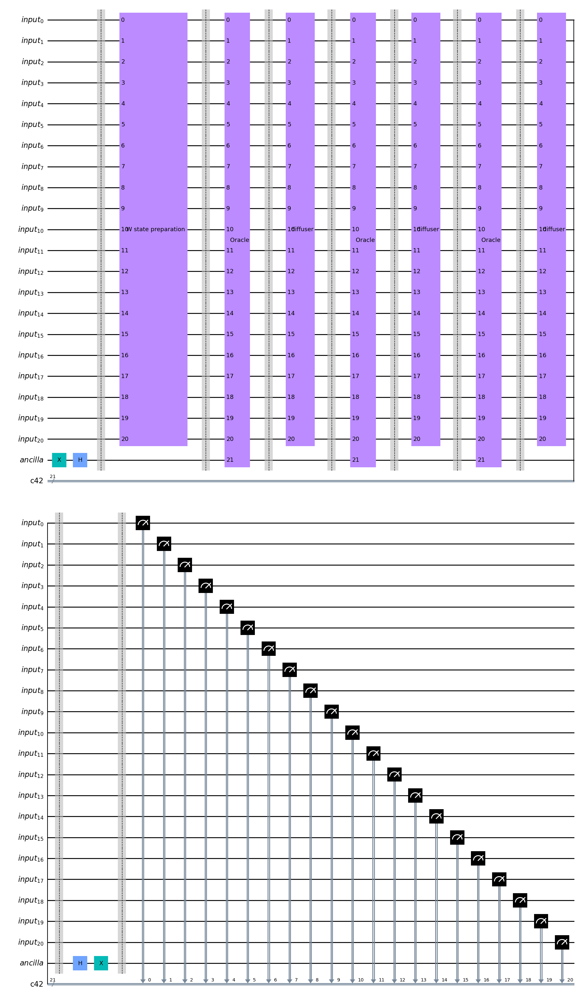


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


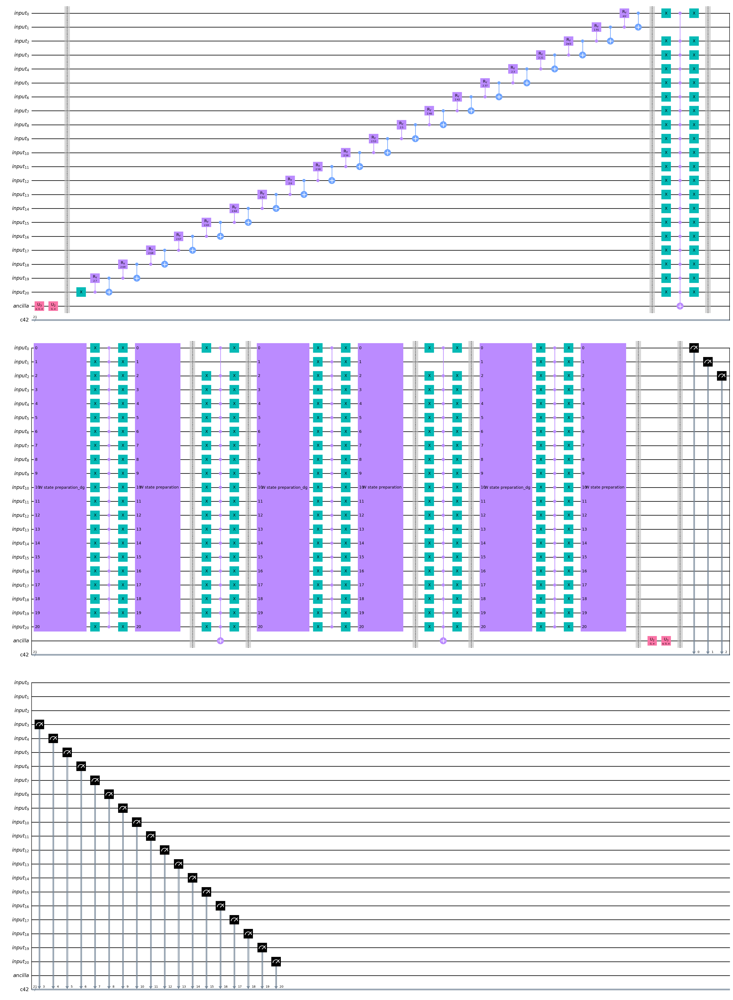


-------------------------------------------------------------------------------------------------------------------

RESULTS:


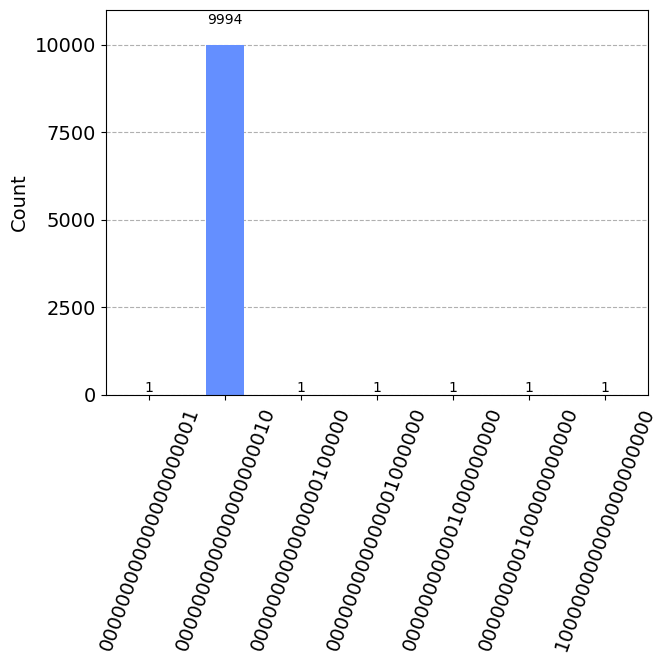

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 22 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  3.1555679478730476
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


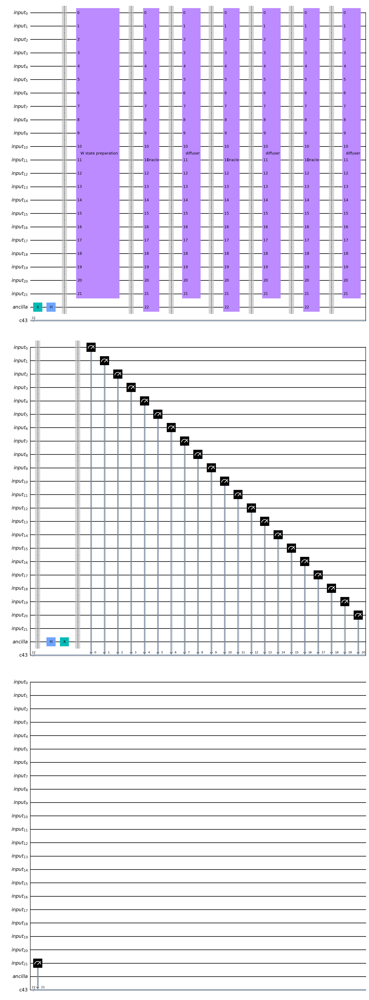


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


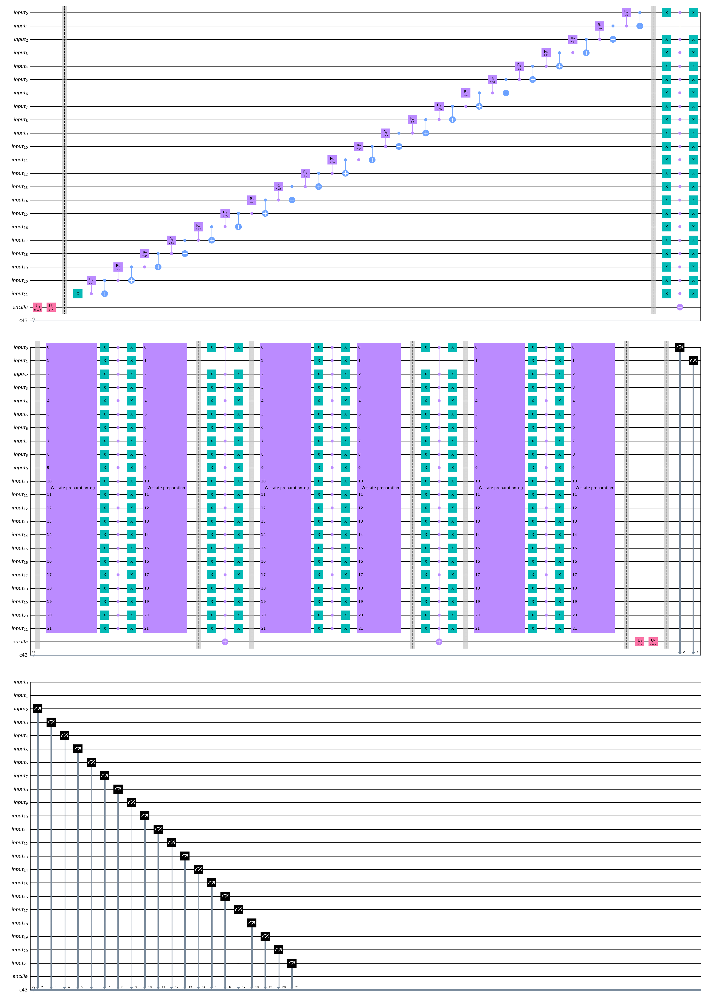


-------------------------------------------------------------------------------------------------------------------

RESULTS:


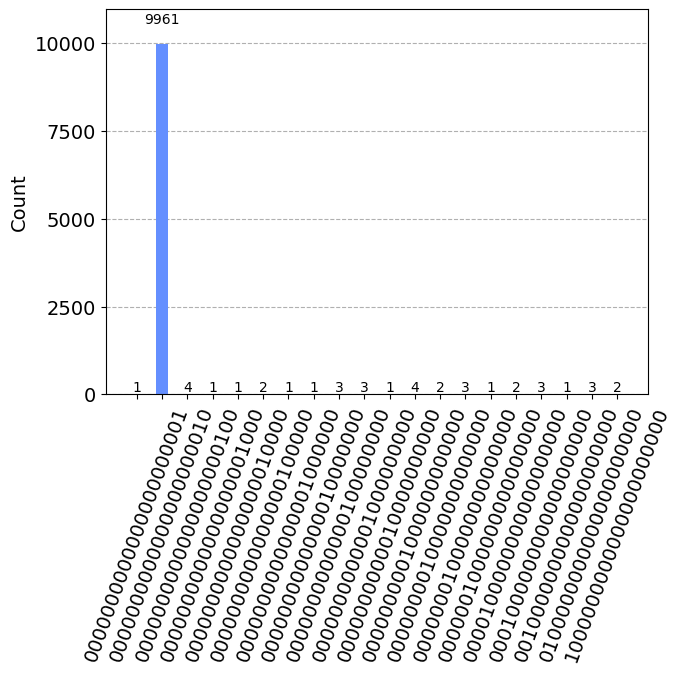

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 23 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  3.2389988336909292
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


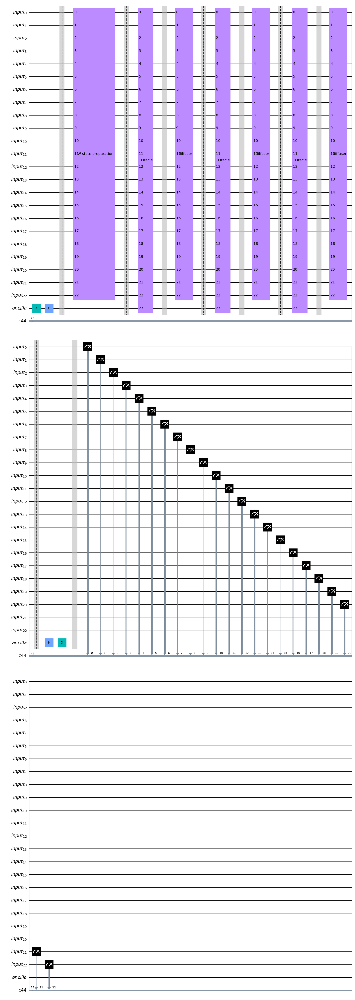


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


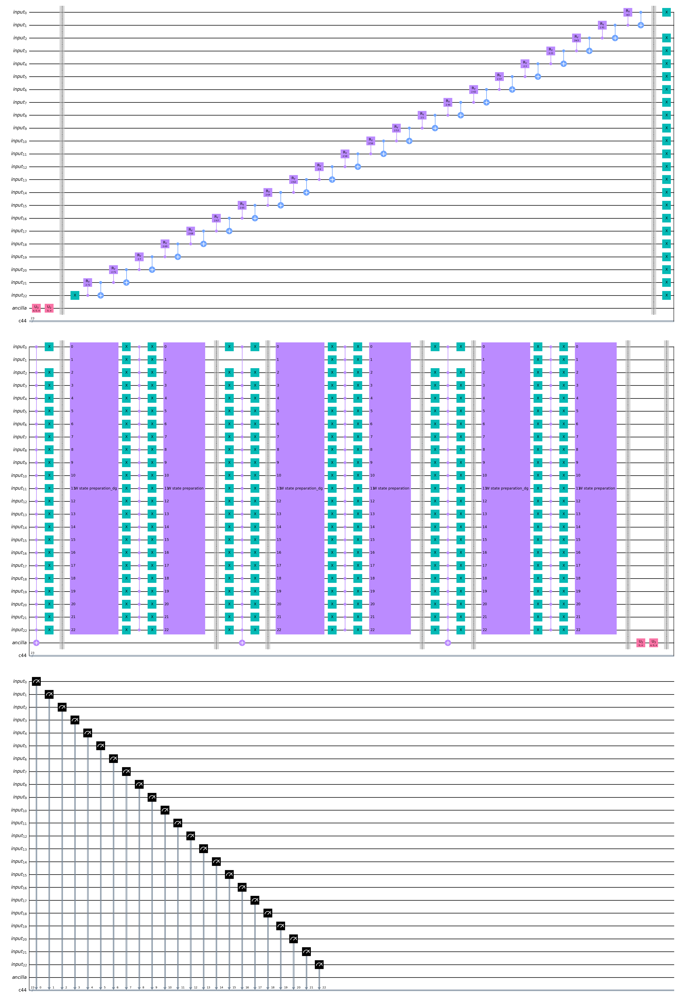


-------------------------------------------------------------------------------------------------------------------

RESULTS:


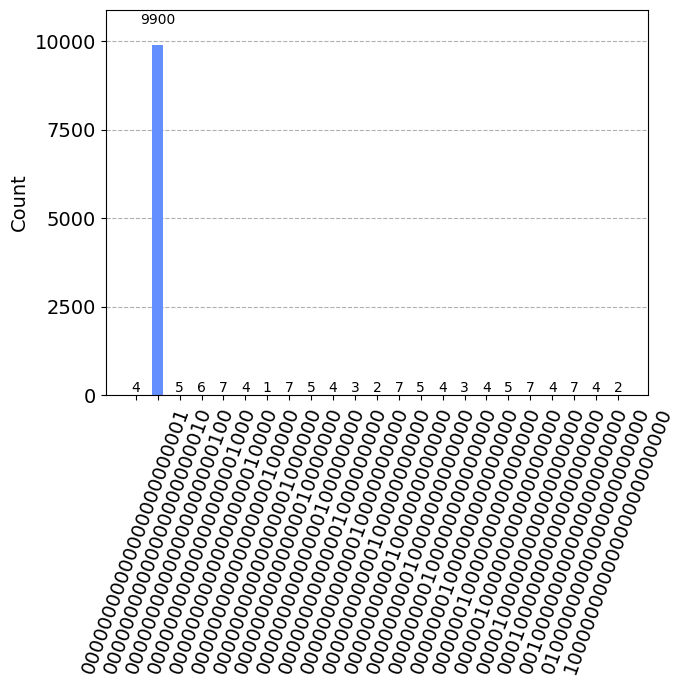

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 24 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  3.3206073211601526
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


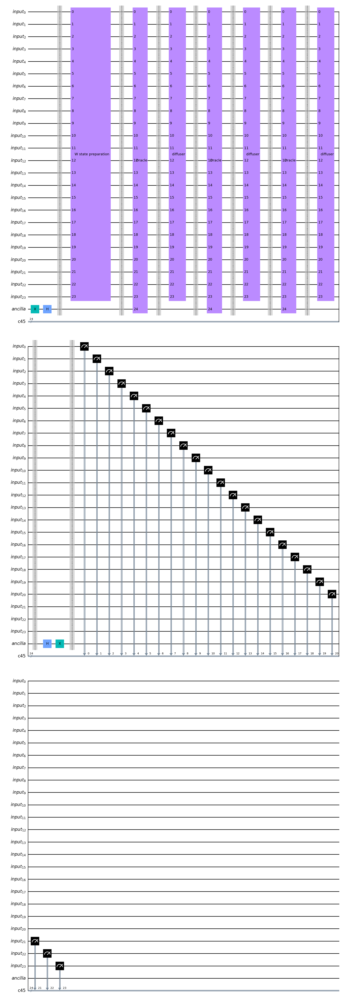


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


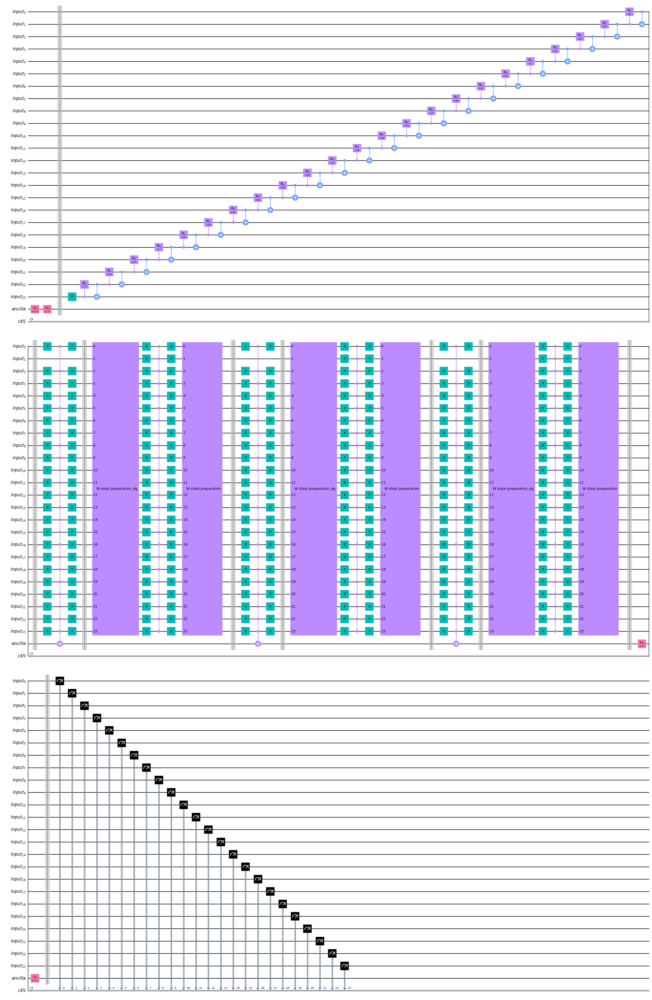


-------------------------------------------------------------------------------------------------------------------

RESULTS:


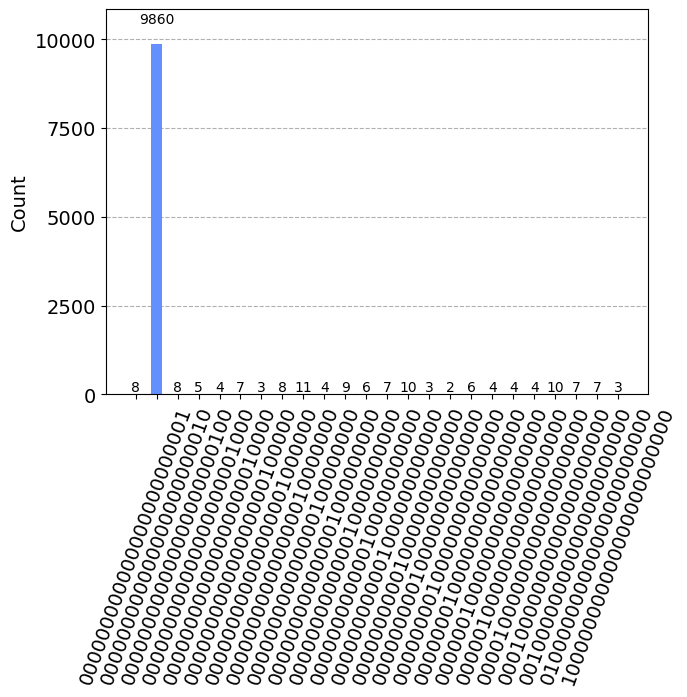

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 25 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  3.4005079130473574
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


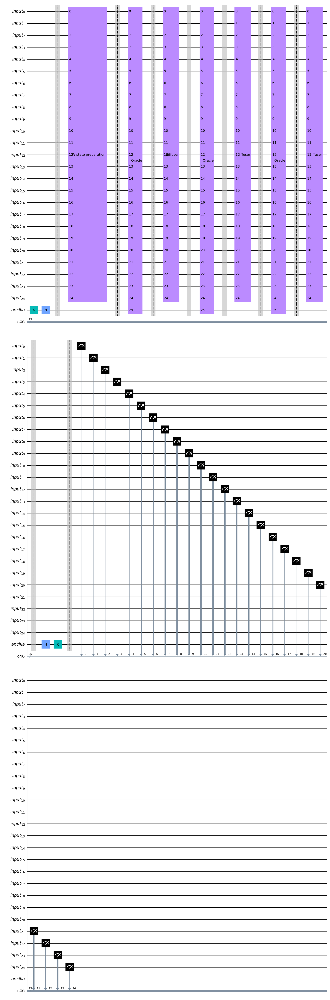


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


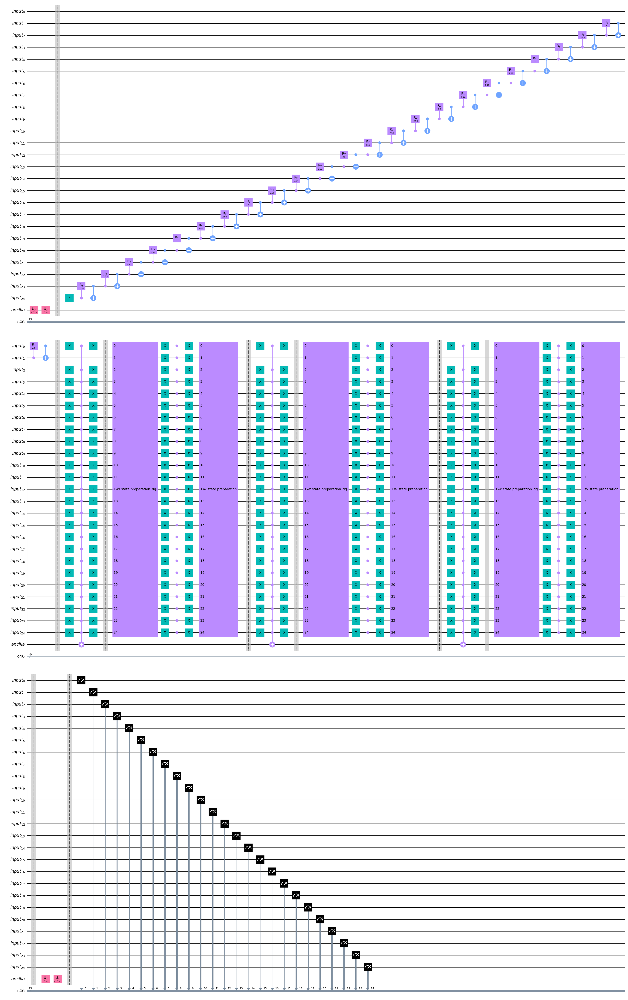


-------------------------------------------------------------------------------------------------------------------

RESULTS:


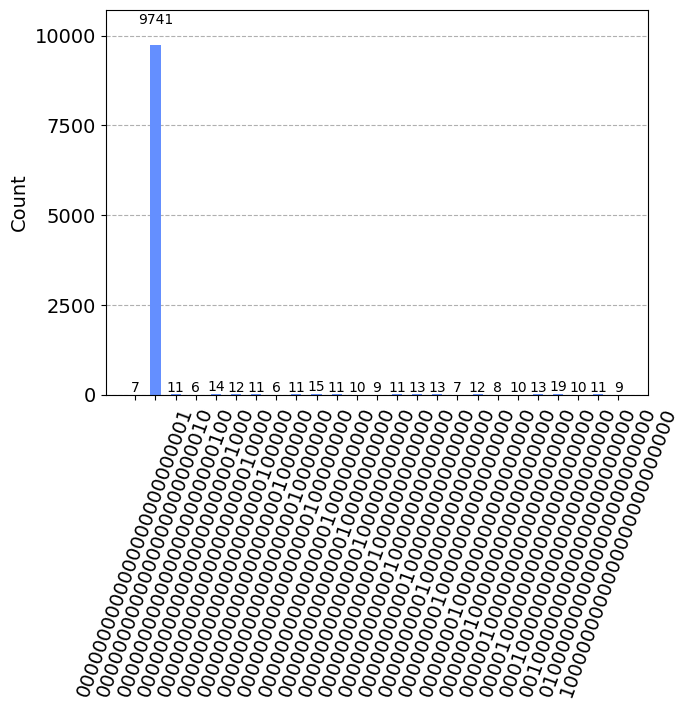

In [9]:
from numpy import pi,arcsin,sqrt

#PLEASE MARKED STATE TO EXPERIMENT WITH DIFFERENT COMBINATIONS FOR THE PROBLEM
#MARKED STATE SHOULD BE THE VALUE WHERE THE CORRECT DOOR WILL BE PLACED
#FOR EXAMPLE, IF THERE ARE 8 DOORS AND THE CORRECT DOOR IS THE 4TH ONE FROM RIGHT TO LEFT, MARKED_STATE=3
#AND REPRESENTS THE STRING 00001000
marked_state = 1
results = []

# Our algorithm will be run from 3 doors up to 25 doors
for n in range(3,26):
    print('-------------------------------------------------------------------------------------------------------------------')
    print('.................................................NUMBER OF DOORS=',n,'................................................')
    print('-------------------------------------------------------------------------------------------------------------------')

    #iterations calculus
    a = (pi/4) 
    b = 1/arcsin(sqrt(1/(n)))
    c=1/2
    r = a * b - c
    iterations_amount = round(a * b - c)


    print()
    print('r = ',r)
    print('amount of iterations for oracle + diffuser:',iterations_amount)
    print()
    print('-------------------------------------------------------------------------------------------------------------------')
    qr = QuantumRegister(n,name="input")
    ancilla = QuantumRegister(1,name="ancilla")
    qc = ClassicalRegister(n)
    qc = QuantumCircuit(qr,ancilla,qc)

    # state preparation |-> for the ancilla
    qc.x(n)
    qc.h(n)
    qc.barrier()

    # W state preparation
    qc.append(w_cir(n),range(n))
    qc.barrier()

    for i in range(iterations_amount):
        # oracle
        qc.append(oracle(n,marked_state),range(n+1))
        qc.barrier()

        # diffuser
        qc.append(diffuser(n),range(n))
        qc.barrier()


    qc.h(n)
    qc.x(n)
    qc.barrier()

    qc.measure(range(n),range(n))


    print('CIRCUIT:')
    display(qc.draw('mpl'))
    print()
    print('-------------------------------------------------------------------------------------------------------------------')
    print()
    print('DECOMPOSED CIRCUIT:')
    display(qc.decompose().draw('mpl',fold=50))
    print()
    print('-------------------------------------------------------------------------------------------------------------------')
    print()

    print('RESULTS:')
    localSimulator = Aer.get_backend('qasm_simulator')
    result = execute(qc, localSimulator, shots=10000).result()
    counts = result.get_counts(qc)
    display(plot_histogram(counts))
    results.append(counts)

In [12]:
if marked_state == 2:
    state = ''
success_probs = []
string = '010'

for result in results:
    #print(string)
    success_probs.append(result[string]/100)
    string = '0'+string


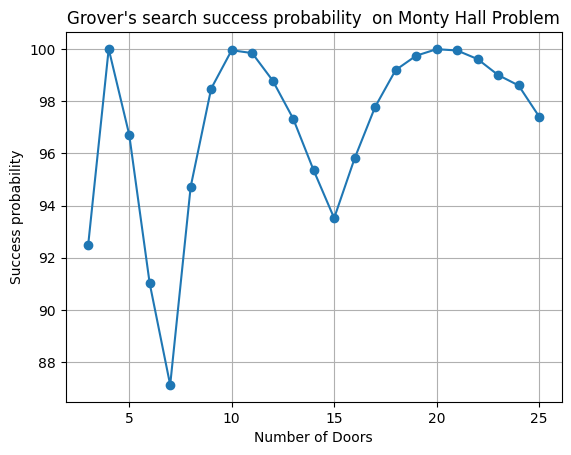

In [13]:
import matplotlib.pyplot as plt

plt.plot(range(3,26), success_probs, marker='o', linestyle='-')

plt.xlabel('Number of Doors')
plt.ylabel('Success probability')

plt.title('Grover\'s search success probability  on Monty Hall Problem')

plt.grid(True)
plt.show()

We found something very interesting from this simulations. It's observe that the succes probability keep increasing and decreasing constantly throughout the function plot. That means that, for any amount of doors $x$ that generate a bad success probability in the circuit (for example, a success probability under $95\%$), it exists an amount of doors $y>x$ that generate a good success probability in te circuit. Watching the plot, we can see that some examples for this affirmation are $x=7, y=10$ or $x=15, y=20$.

We propose a modification for the algorithm, that involves adding "fake" or "artifitial" doors when the current amount of doors does not result in a good success probability. When doing that, we force the algorithm to run itself with an amount of doors that guarantees a good perfomance. Adding this artifitial doors doesn't affect the formulation of the problem. That is because if you have to find the correct door in a bounch of unknown doors, if you add $n$ incorrect doors more, the correct door will be same one.

For trying this idea, we will suppose that the only amount of gates that guarantees a good performance of the algorithm are 5, 10 and 20. This is an extreme limitation since there other amount of gates like 11 where the algorithm keep having a good performace, but we decide to reduce the problem up to 5, 10 and 20 for experiment purpose.

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 3 ................................................
-------------------------------------------------------------------------------------------------------------------
The amount of doors has been changed to 4 !!!

r =  0.9999999999999998
amount of iterations for oracle + diffuser: 1

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


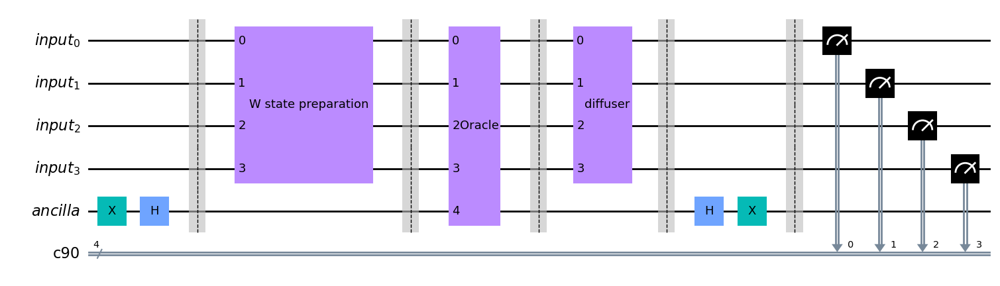


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


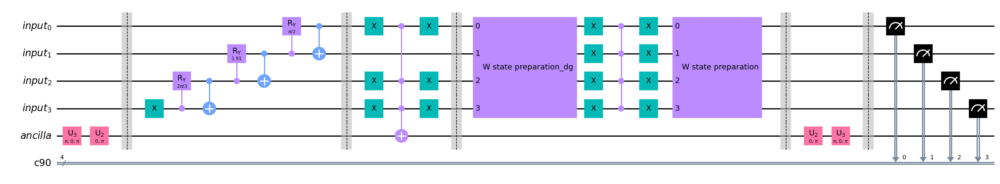


-------------------------------------------------------------------------------------------------------------------

RESULTS:


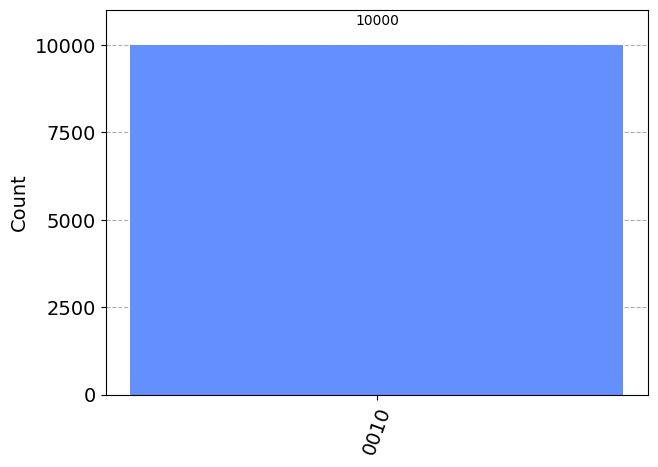

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 4 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  0.9999999999999998
amount of iterations for oracle + diffuser: 1

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


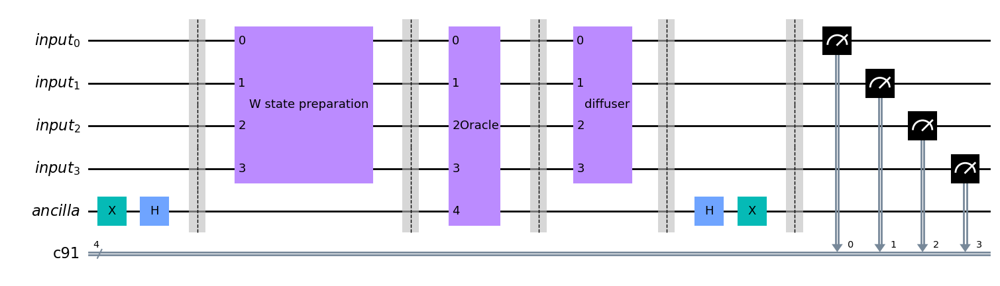


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


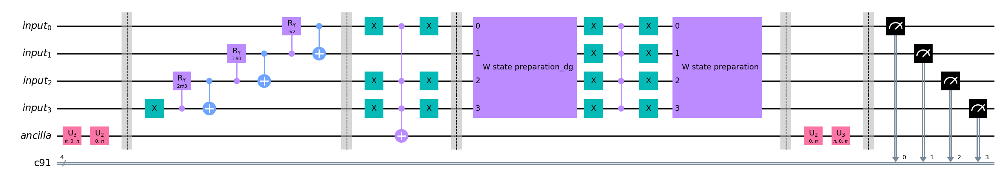


-------------------------------------------------------------------------------------------------------------------

RESULTS:


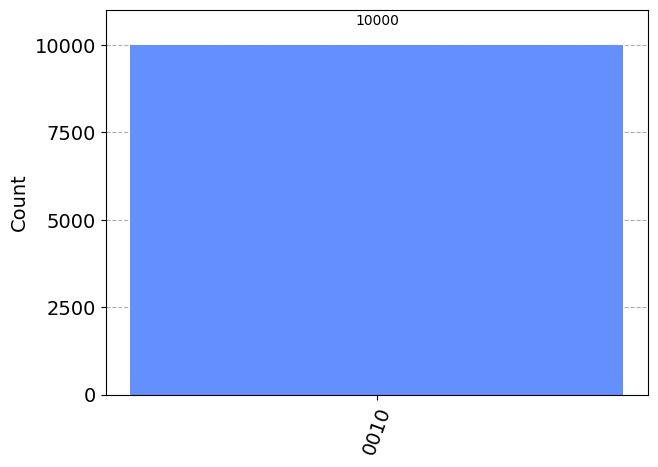

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 5 ................................................
-------------------------------------------------------------------------------------------------------------------
go
The amount of doors has been changed to 10 !!!

r =  1.9410157268268091
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


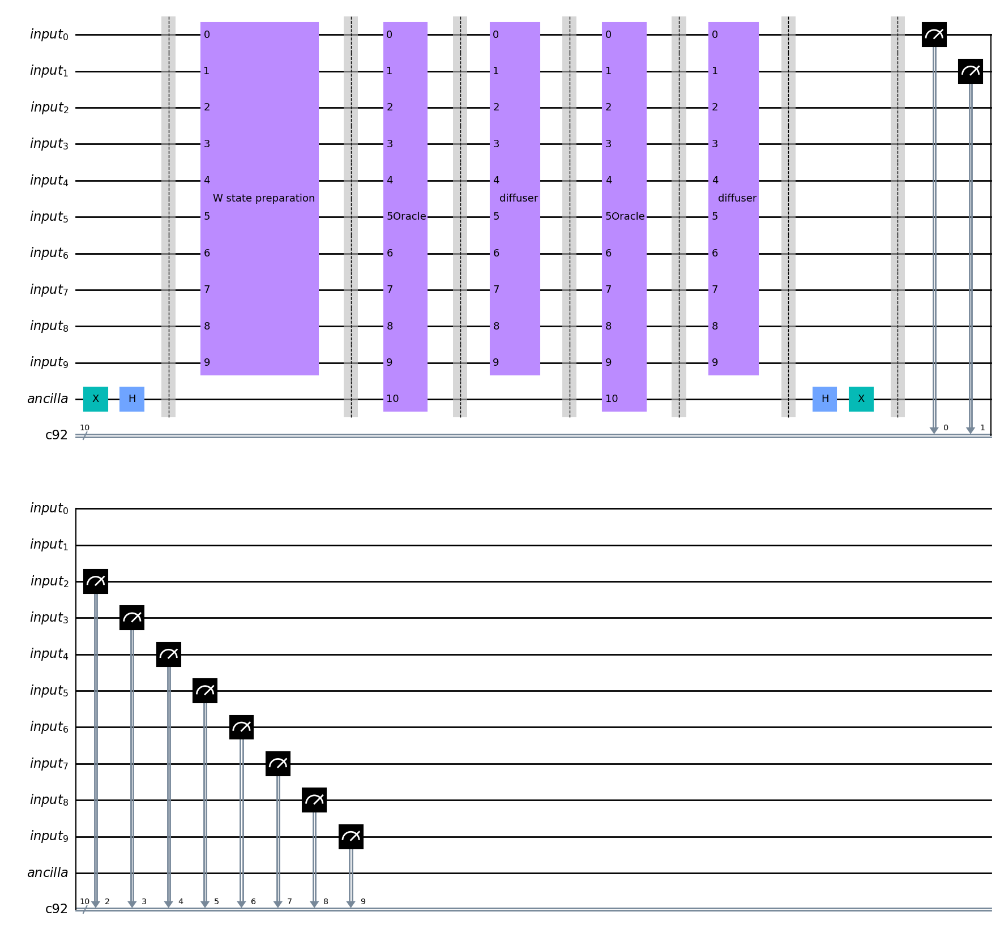


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


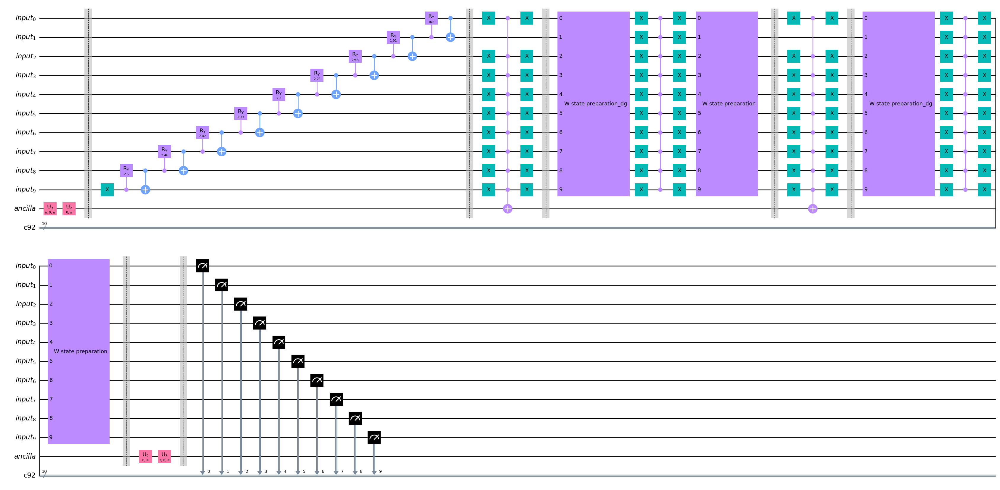


-------------------------------------------------------------------------------------------------------------------

RESULTS:


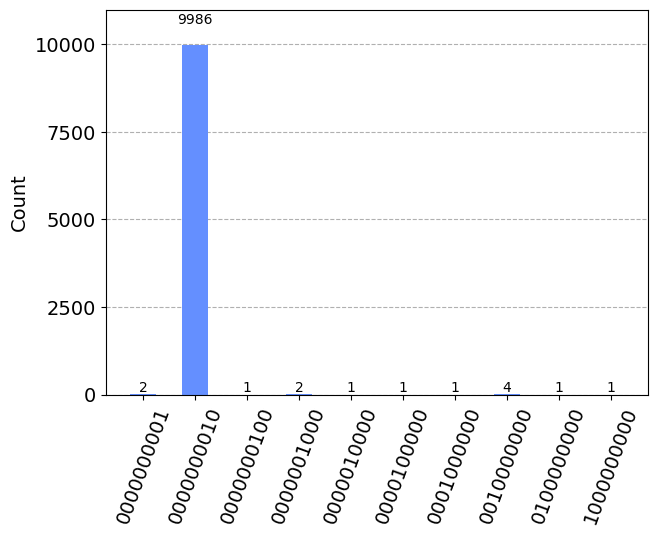

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 6 ................................................
-------------------------------------------------------------------------------------------------------------------
go
The amount of doors has been changed to 10 !!!

r =  1.9410157268268091
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


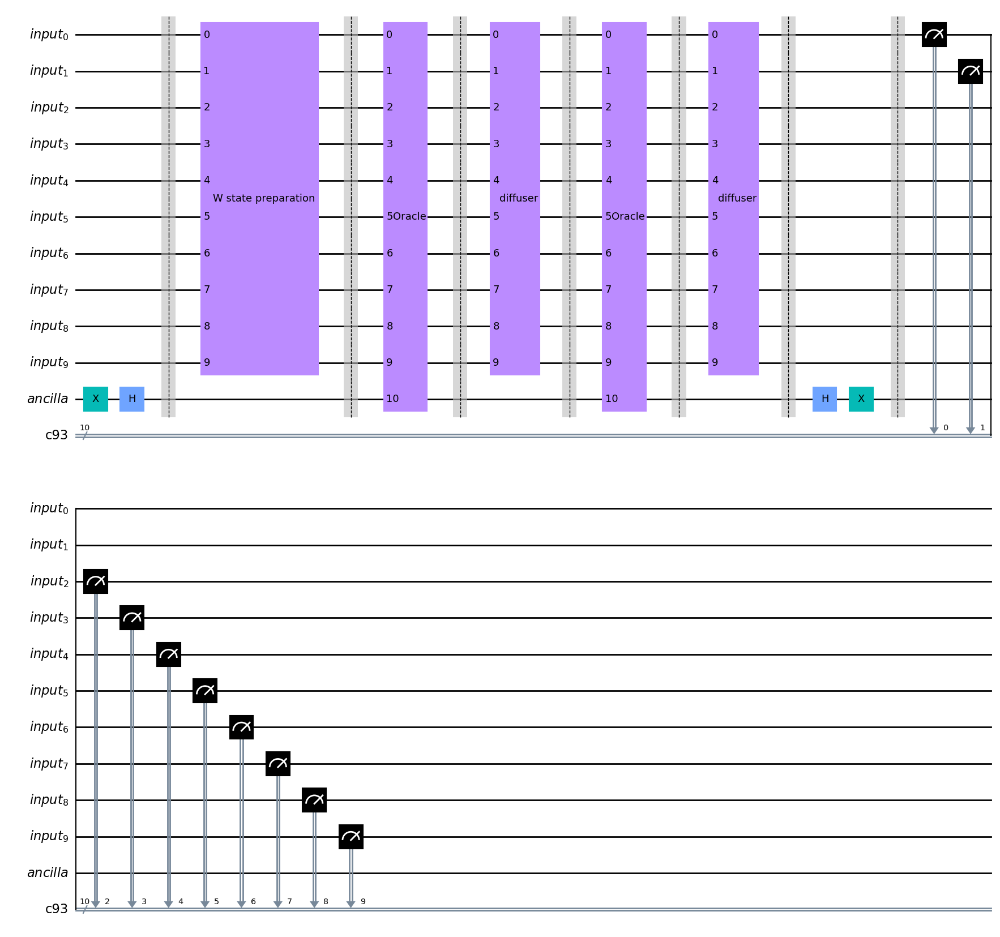


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


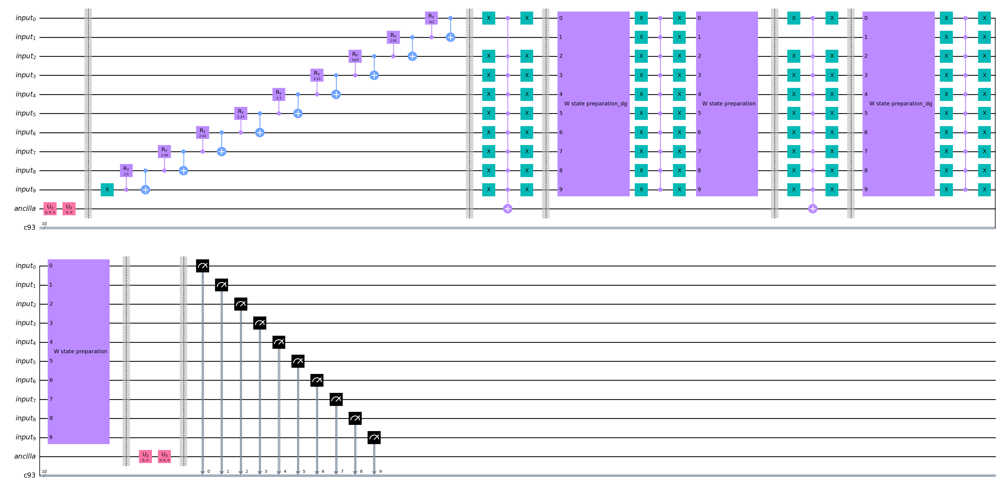


-------------------------------------------------------------------------------------------------------------------

RESULTS:


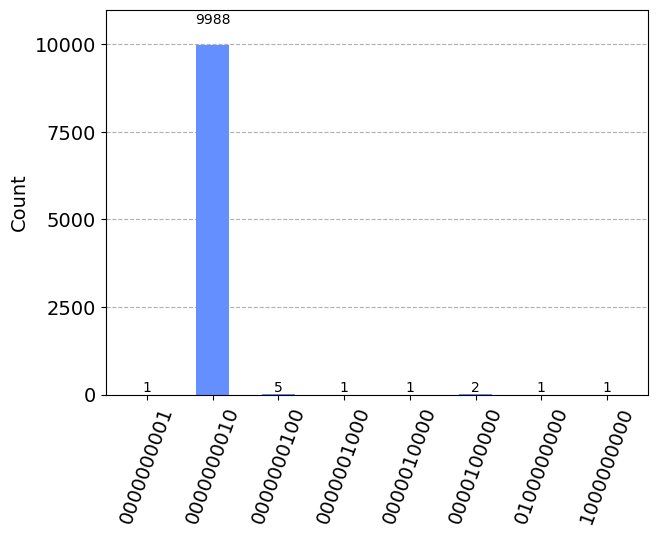

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 7 ................................................
-------------------------------------------------------------------------------------------------------------------
go
The amount of doors has been changed to 10 !!!

r =  1.9410157268268091
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


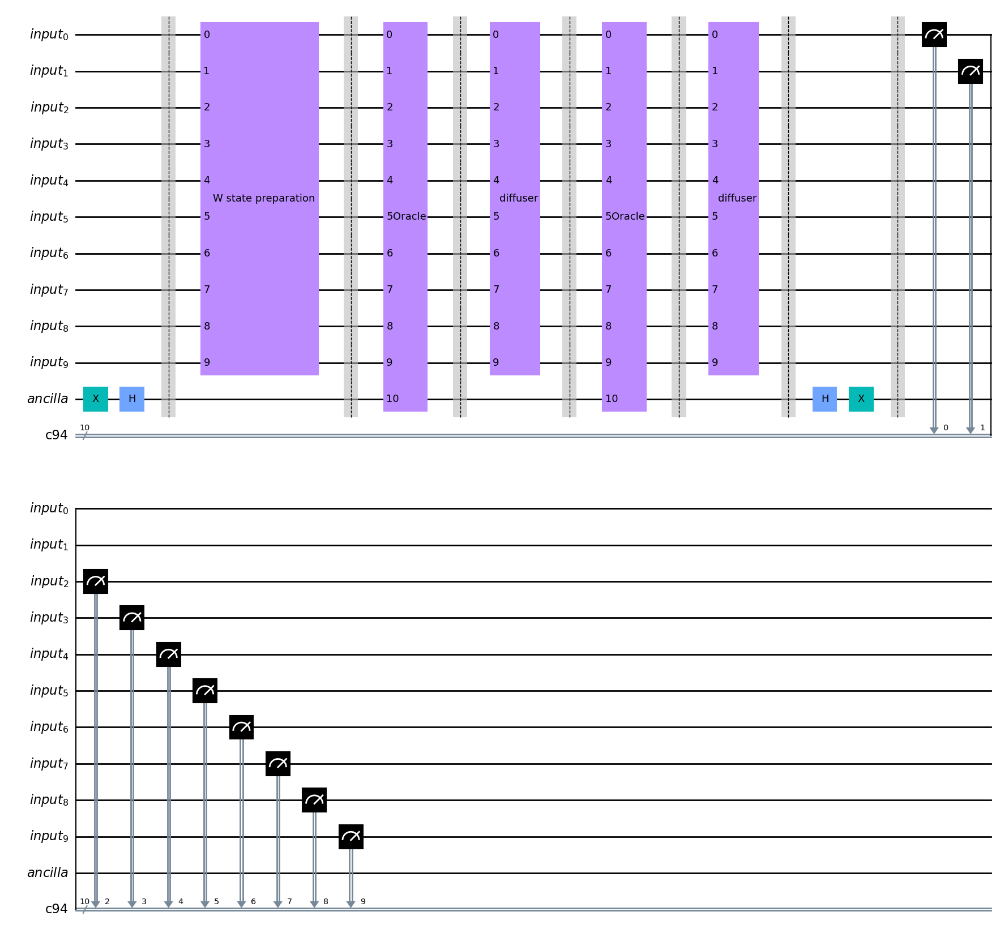


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


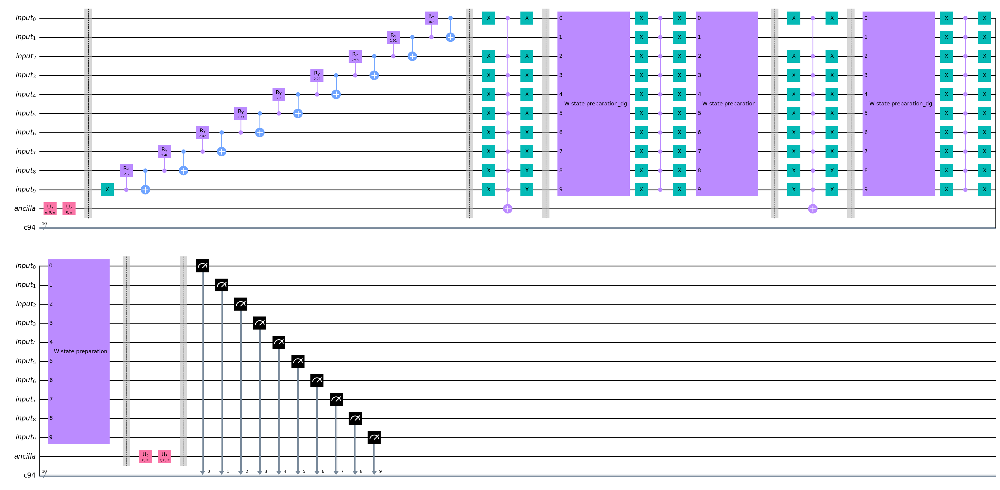


-------------------------------------------------------------------------------------------------------------------

RESULTS:


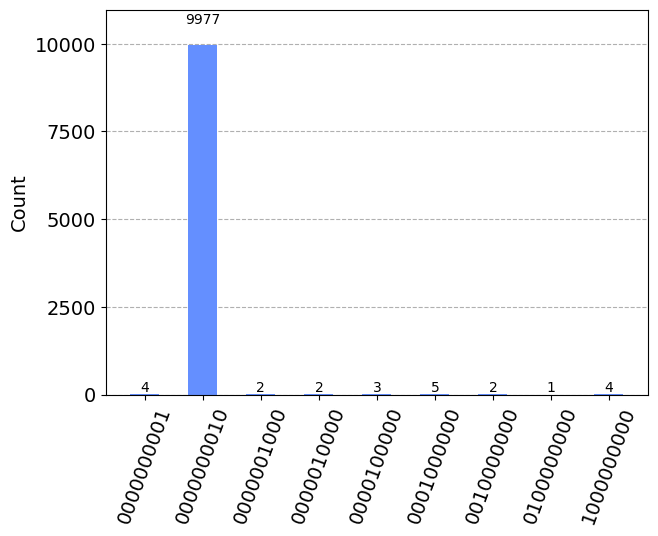

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 8 ................................................
-------------------------------------------------------------------------------------------------------------------
go
The amount of doors has been changed to 10 !!!

r =  1.9410157268268091
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


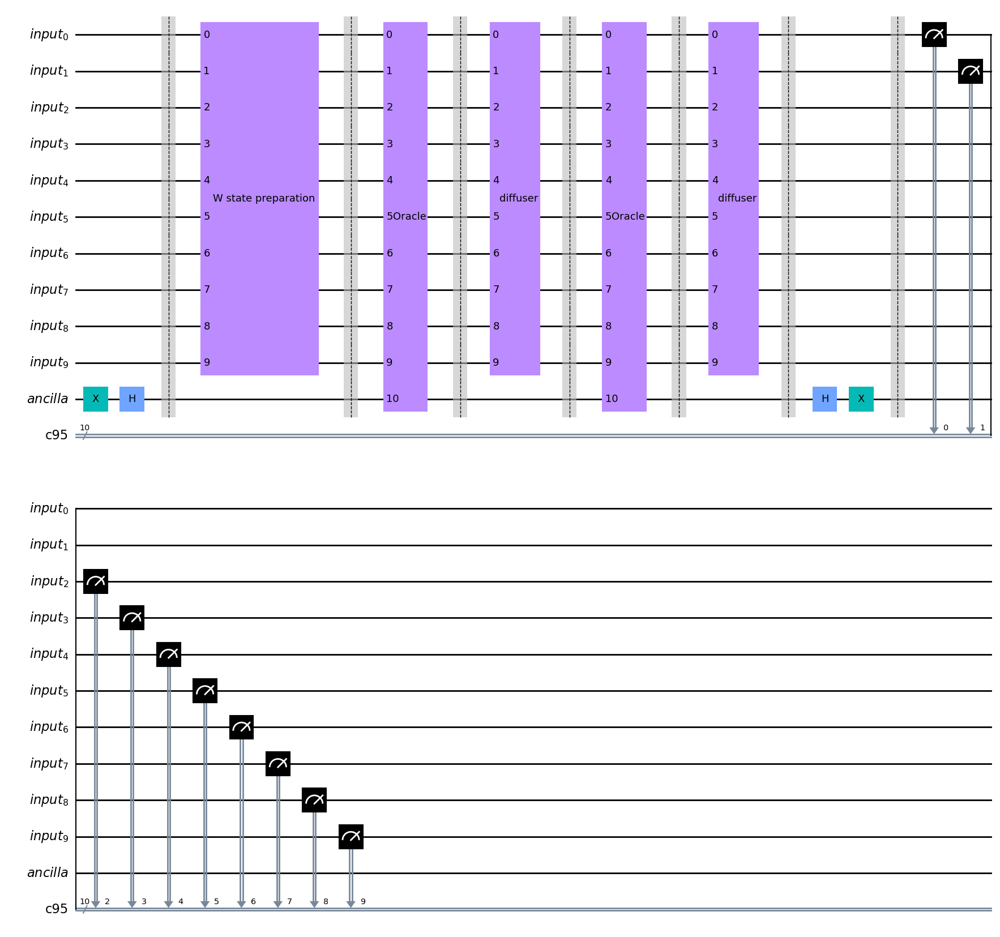


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


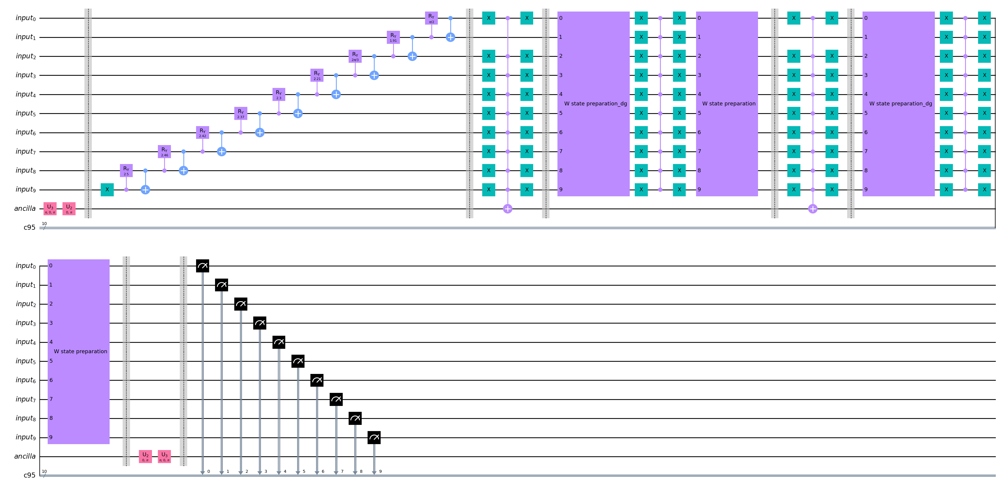


-------------------------------------------------------------------------------------------------------------------

RESULTS:


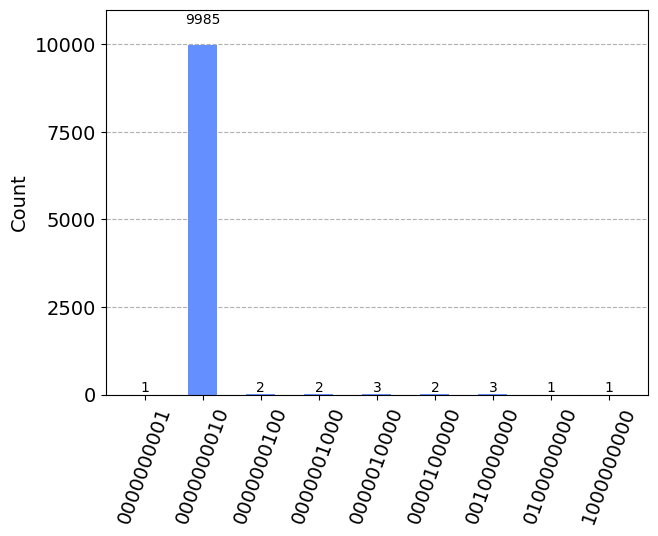

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 9 ................................................
-------------------------------------------------------------------------------------------------------------------
go
The amount of doors has been changed to 10 !!!

r =  1.9410157268268091
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


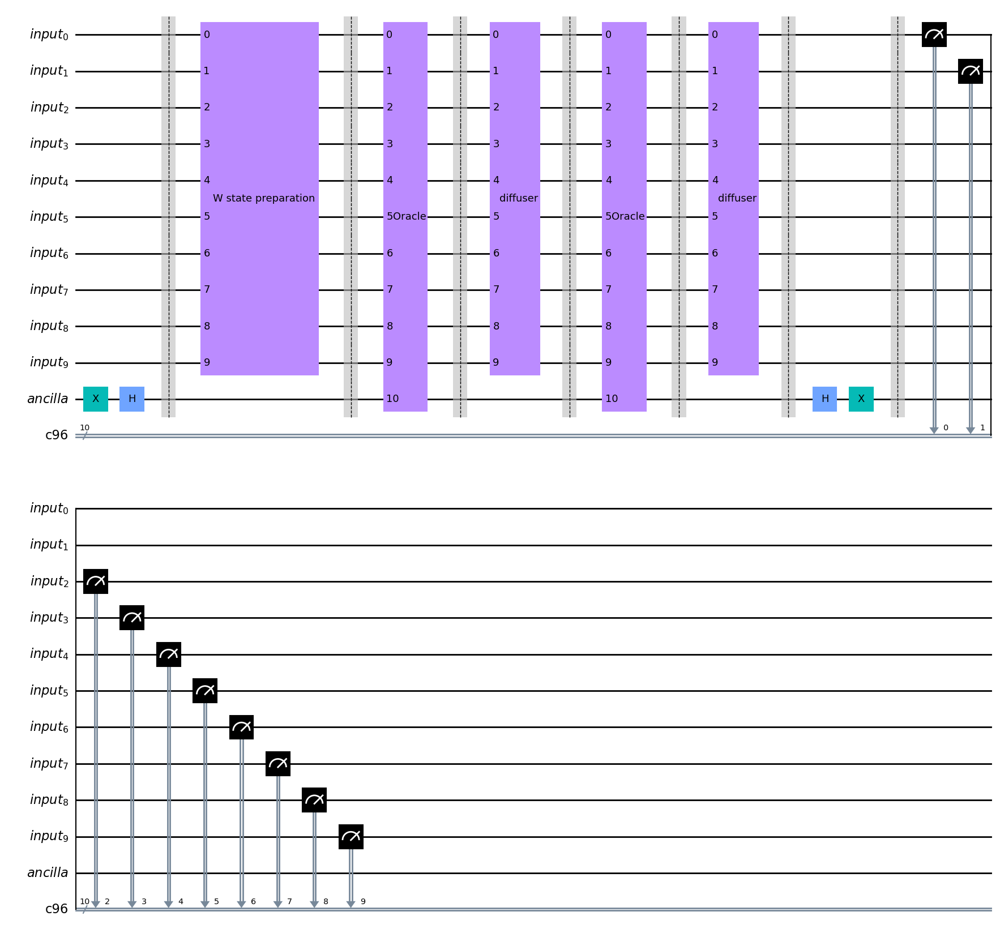


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


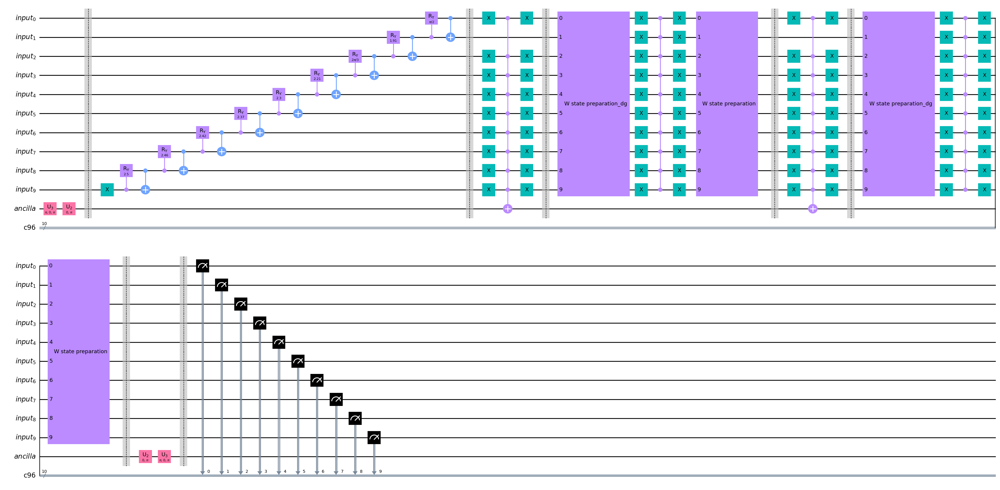


-------------------------------------------------------------------------------------------------------------------

RESULTS:


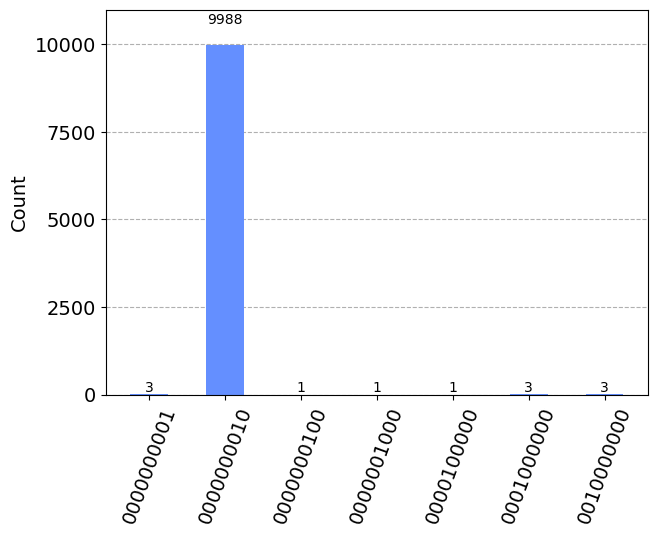

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 10 ................................................
-------------------------------------------------------------------------------------------------------------------

r =  1.9410157268268091
amount of iterations for oracle + diffuser: 2

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


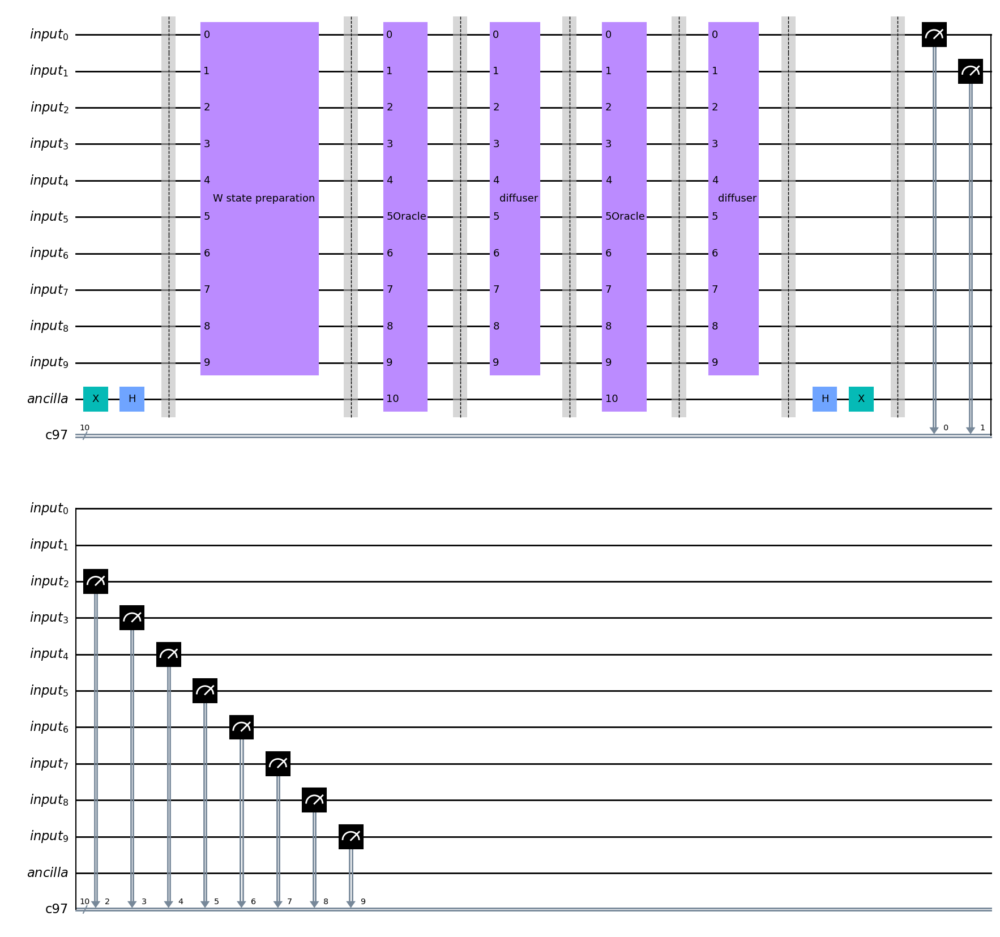


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


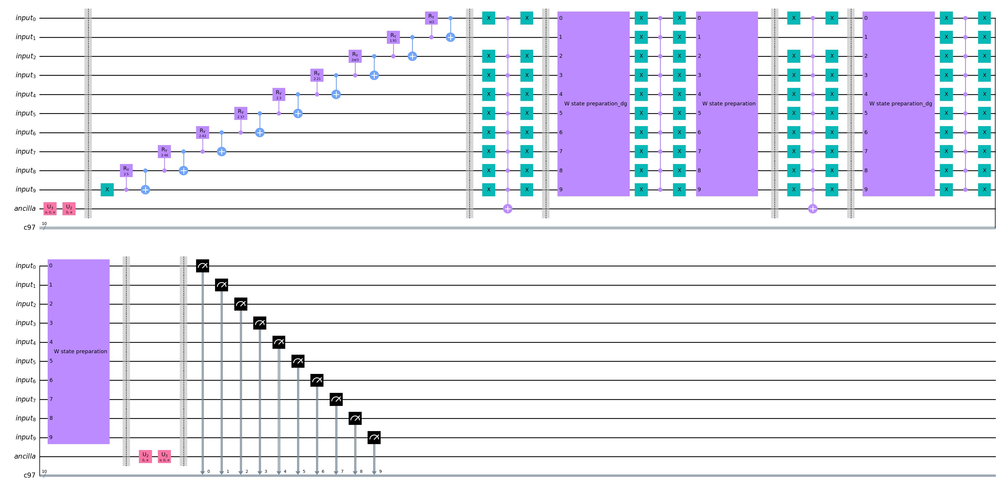


-------------------------------------------------------------------------------------------------------------------

RESULTS:


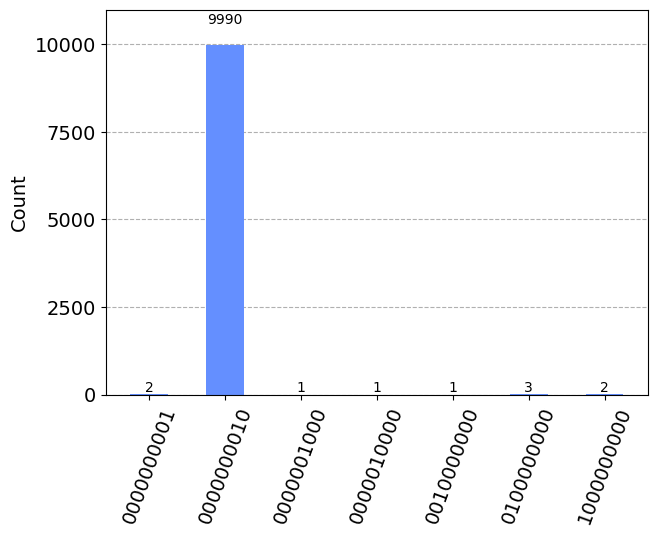

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 11 ................................................
-------------------------------------------------------------------------------------------------------------------
go
go
The amount of doors has been changed to 20 !!!

r =  2.9827116386696226
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


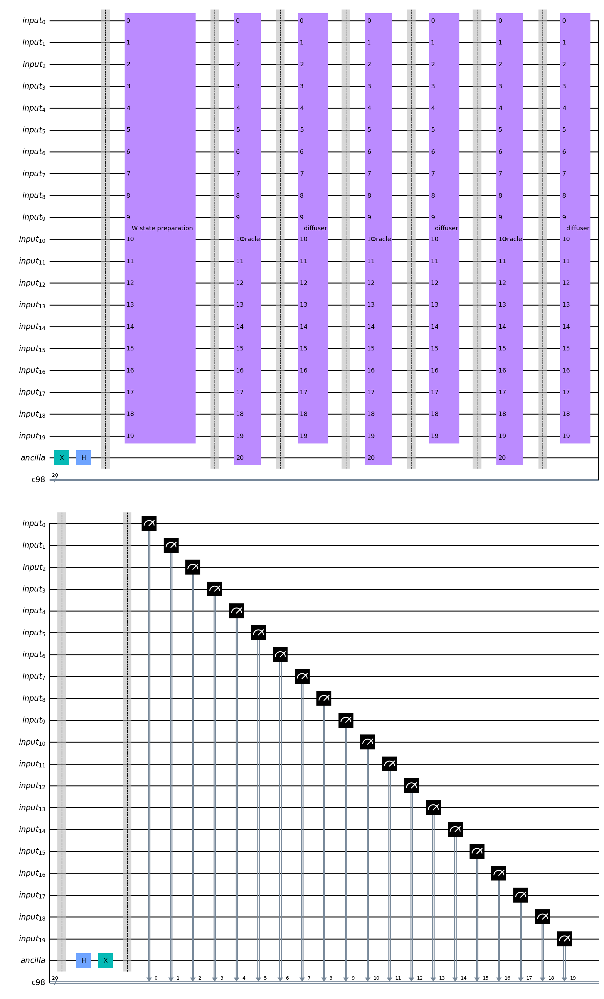


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


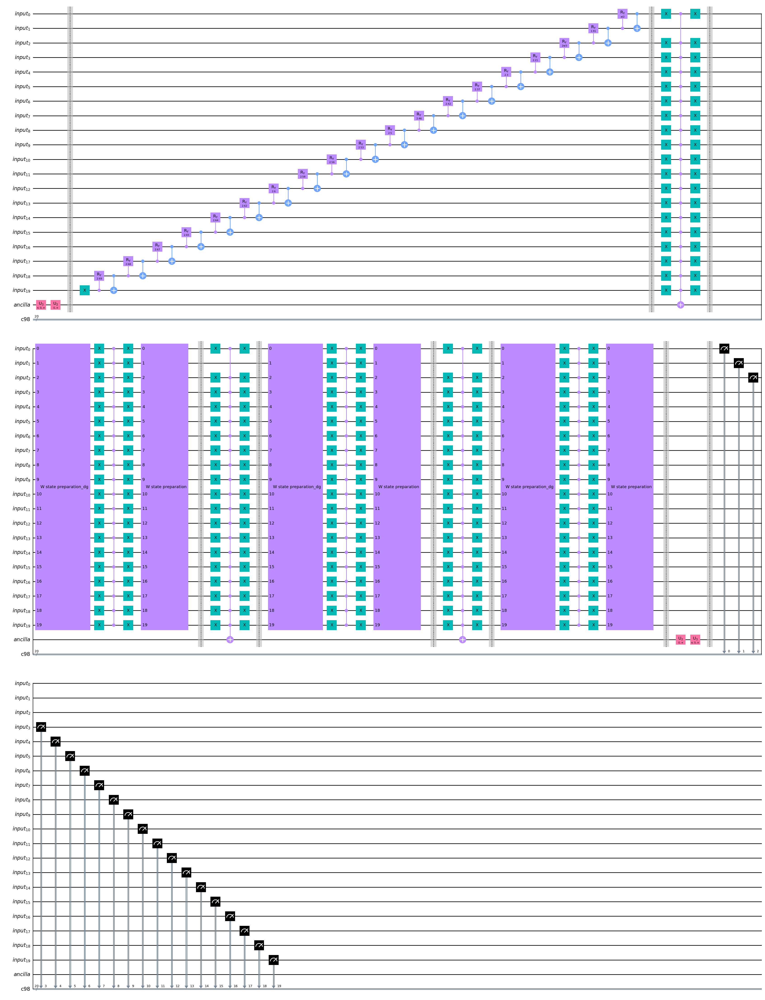


-------------------------------------------------------------------------------------------------------------------

RESULTS:


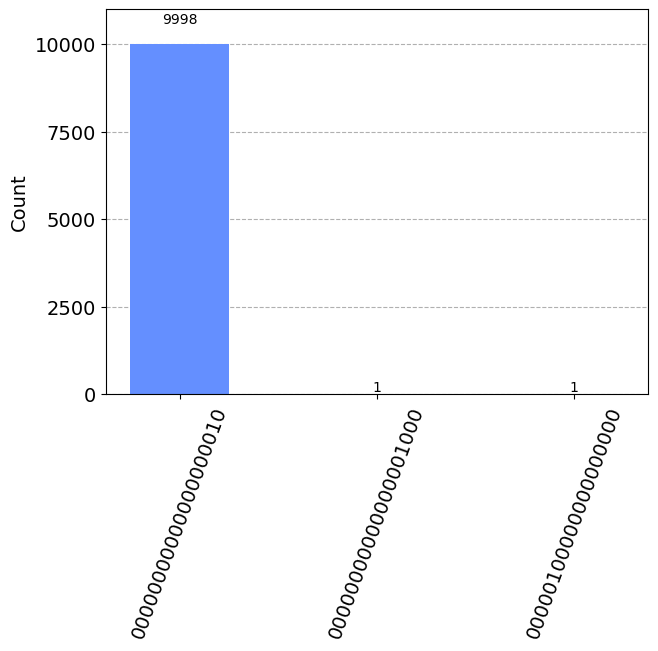

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 12 ................................................
-------------------------------------------------------------------------------------------------------------------
go
go
The amount of doors has been changed to 20 !!!

r =  2.9827116386696226
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


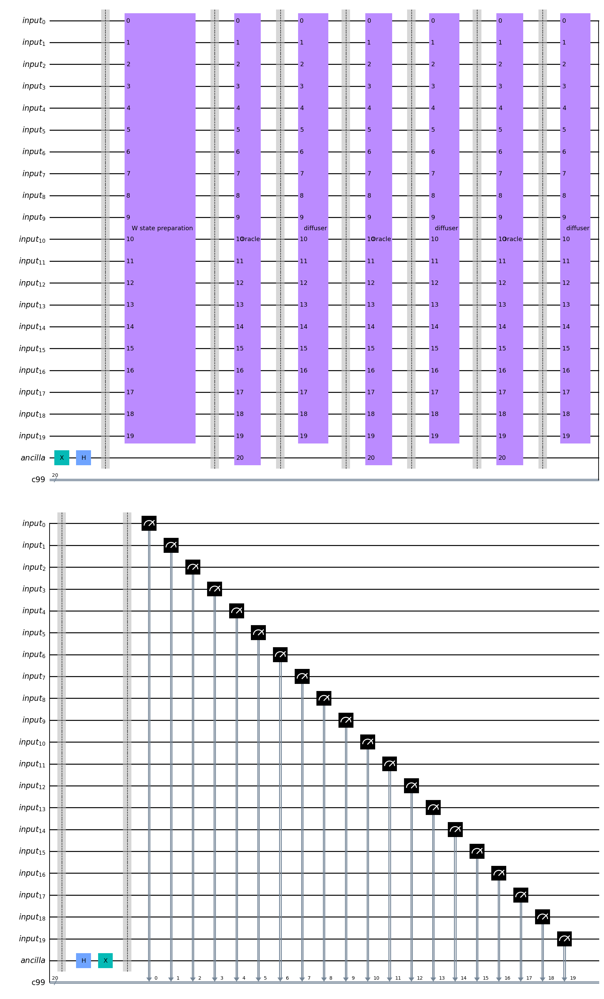


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


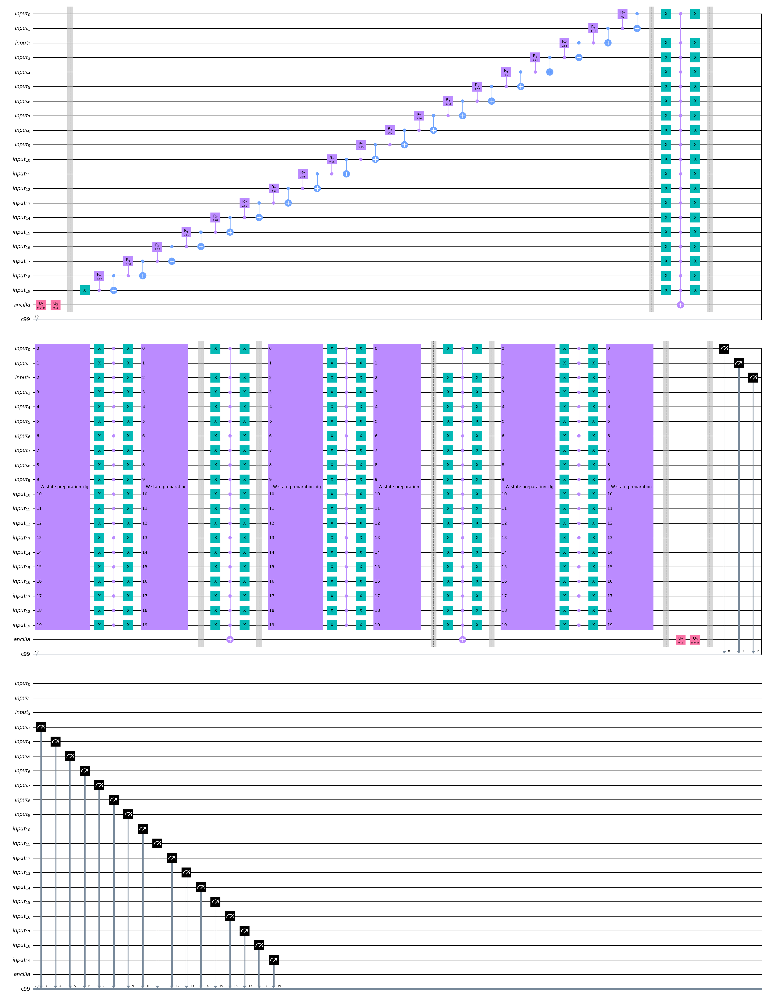


-------------------------------------------------------------------------------------------------------------------

RESULTS:


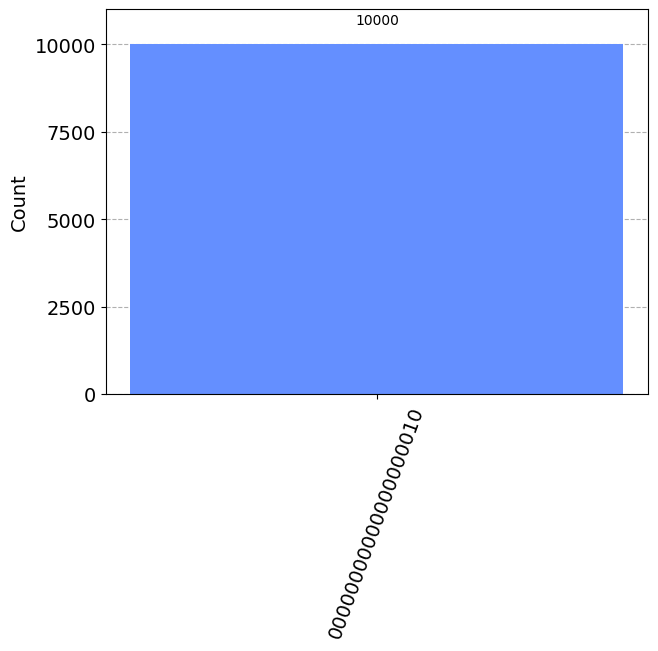

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 13 ................................................
-------------------------------------------------------------------------------------------------------------------
go
go
The amount of doors has been changed to 20 !!!

r =  2.9827116386696226
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


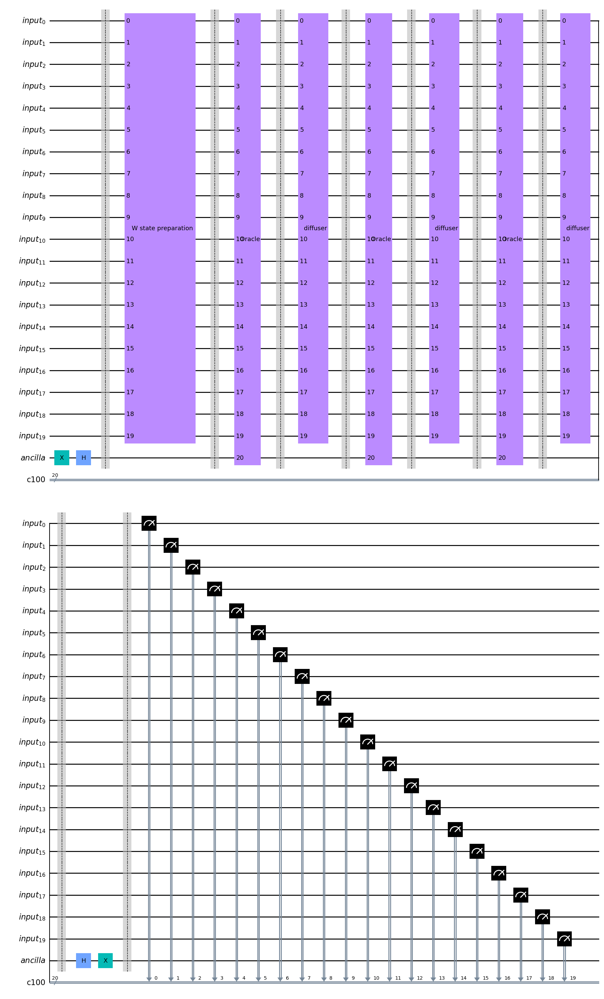


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


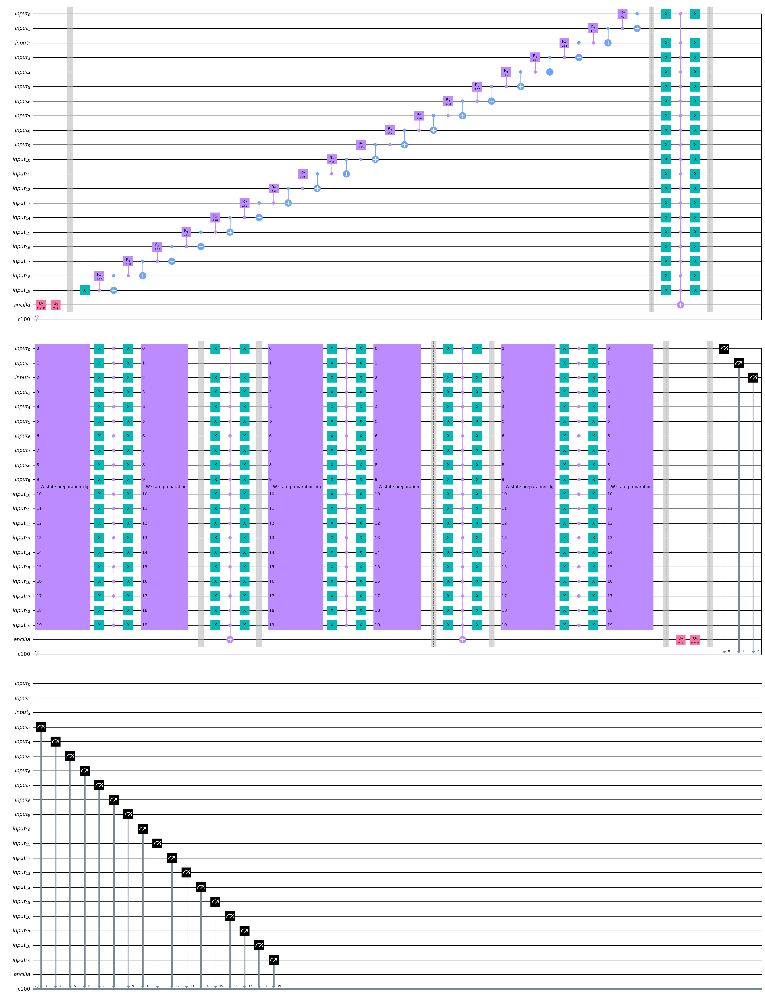


-------------------------------------------------------------------------------------------------------------------

RESULTS:


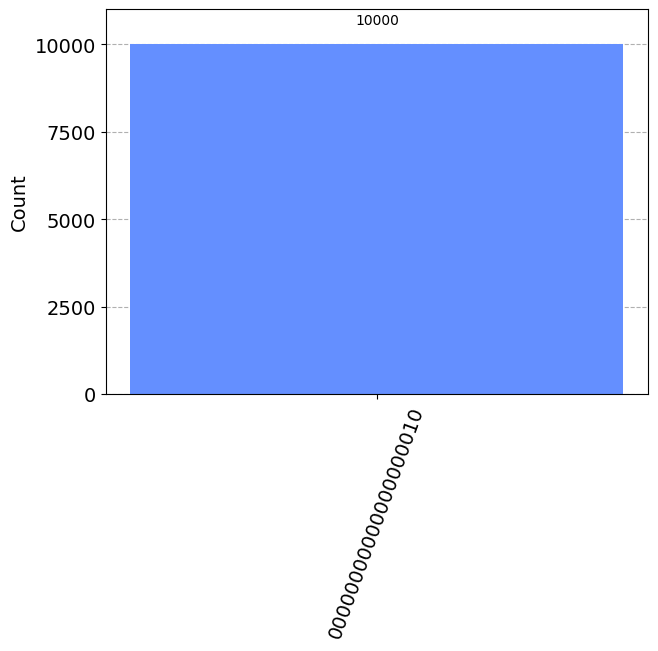

-------------------------------------------------------------------------------------------------------------------
.................................................NUMBER OF DOORS= 14 ................................................
-------------------------------------------------------------------------------------------------------------------
go
go
The amount of doors has been changed to 20 !!!

r =  2.9827116386696226
amount of iterations for oracle + diffuser: 3

-------------------------------------------------------------------------------------------------------------------
CIRCUIT:


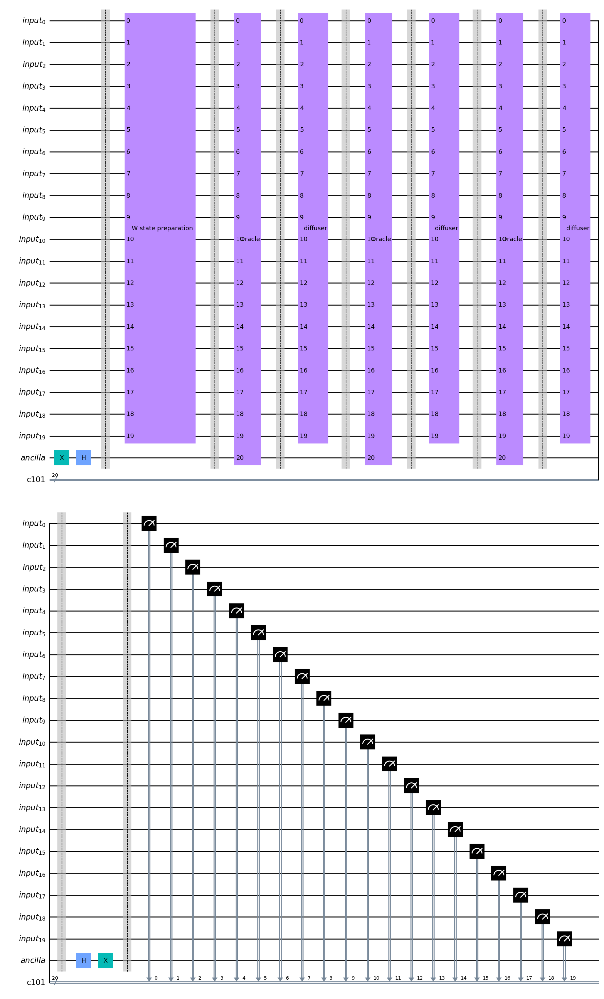


-------------------------------------------------------------------------------------------------------------------

DECOMPOSED CIRCUIT:


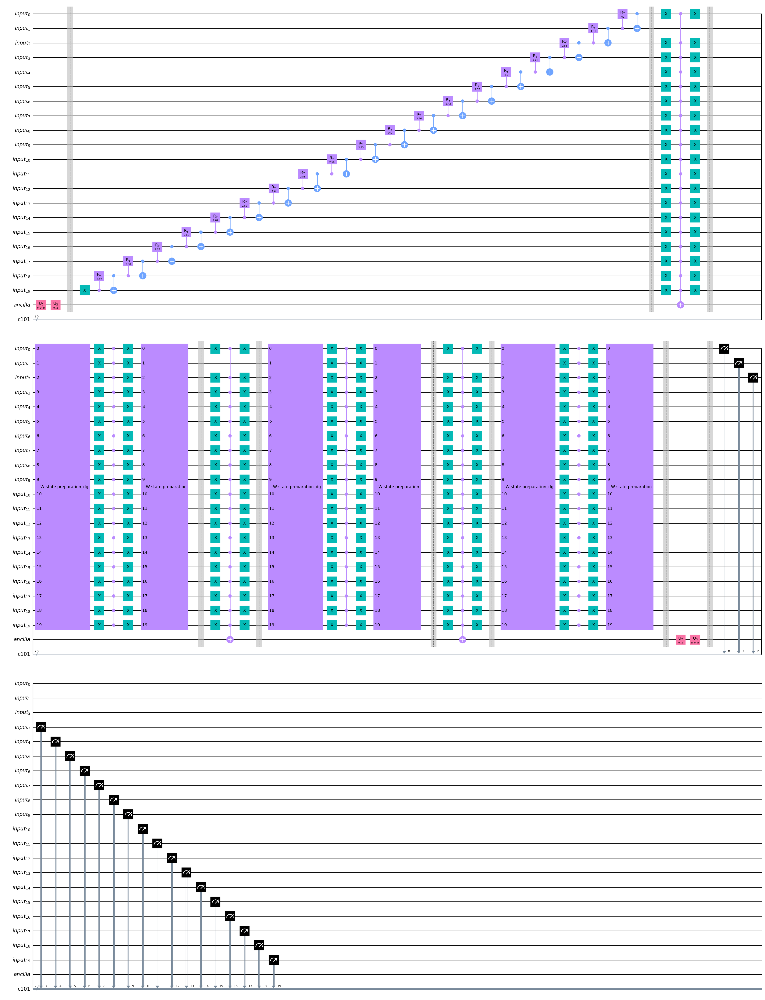


-------------------------------------------------------------------------------------------------------------------

RESULTS:


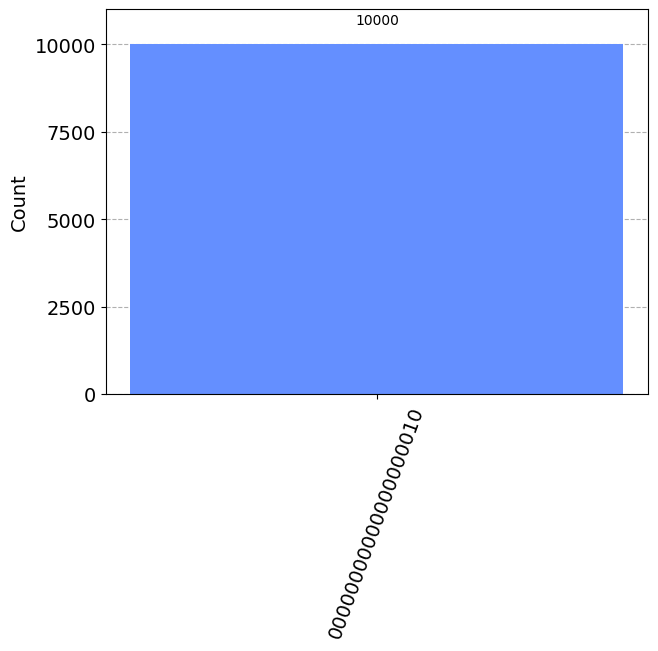

In [36]:
from numpy import pi,arcsin,sqrt

#PLEASE MARKED STATE TO EXPERIMENT WITH DIFFERENT COMBINATIONS FOR THE PROBLEM
#MARKED STATE SHOULD BE THE VALUE WHERE THE CORRECT DOOR WILL BE PLACED
#FOR EXAMPLE, IF THERE ARE 8 DOORS AND THE CORRECT DOOR IS THE 4TH ONE FROM RIGHT TO LEFT, MARKED_STATE=3
#AND REPRESENTS THE STRING 00001000
marked_state = 1
results = []
# these are the optimum amount of doors where we know the circuit has a success probility greater than 98%
optimum_amount_doors = [4,10,20]

# Our algorithm will be run from 3 doors up to 16 doors
for n in range(3,15):
    print('-------------------------------------------------------------------------------------------------------------------')
    print('.................................................NUMBER OF DOORS=',n,'................................................')
    print('-------------------------------------------------------------------------------------------------------------------')

    #iterations calculus
    a = (pi/4) 
    b = 1/arcsin(sqrt(1/(n)))
    c=1/2
    r = a * b - c
    iterations_amount = round(a * b - c)
    #this represents the distance from the r value up the nearest integer value.
    distance_for_integer = abs(r - iterations_amount)

    #if distance to nearest integers is >= 0.29 means is not optimum amount of gates
    if(n not in optimum_amount_doors):
        pos = 0
        while optimum_amount_doors[pos] < n:
            print('go')
            pos = pos + 1
        n = optimum_amount_doors[pos]
        print('The amount of doors has been changed to',n,'!!!')
        
        #new iterations calculus
        a = (pi/4) 
        b = 1/arcsin(sqrt(1/(n)))
        c=1/2
        r = a * b - c
        iterations_amount = round(a * b - c)
        
    
    print()
    print('r = ',r)
    print('amount of iterations for oracle + diffuser:',iterations_amount)
    print()
    print('-------------------------------------------------------------------------------------------------------------------')
    qr = QuantumRegister(n,name="input")
    ancilla = QuantumRegister(1,name="ancilla")
    qc = ClassicalRegister(n)
    qc = QuantumCircuit(qr,ancilla,qc)

    # state preparation |-> for the ancilla
    qc.x(n)
    qc.h(n)
    qc.barrier()

    # W state preparation
    qc.append(w_cir(n),range(n))
    qc.barrier()

    for i in range(iterations_amount):
        # oracle
        qc.append(oracle(n,marked_state),range(n+1))
        qc.barrier()

        # diffuser
        qc.append(diffuser(n),range(n))
        qc.barrier()


    qc.h(n)
    qc.x(n)
    qc.barrier()

    qc.measure(range(n),range(n))


    print('CIRCUIT:')
    display(qc.draw('mpl'))
    print()
    print('-------------------------------------------------------------------------------------------------------------------')
    print()
    print('DECOMPOSED CIRCUIT:')
    display(qc.decompose().draw('mpl',fold=50))
    print()
    print('-------------------------------------------------------------------------------------------------------------------')
    print()

    print('RESULTS:')
    localSimulator = Aer.get_backend('qasm_simulator')
    result = execute(qc, localSimulator, shots=10000).result()
    counts = result.get_counts(qc)
    display(plot_histogram(counts))
    results.append(counts)

In [38]:
success_probs = []
string = '010'
for result in results:
    biggest_value = -1
    for key in result.keys():
        if result[key] > biggest_value:
            biggest_value = result[key]
    
    success_probs.append(biggest_value/100)
    string = '0'+string


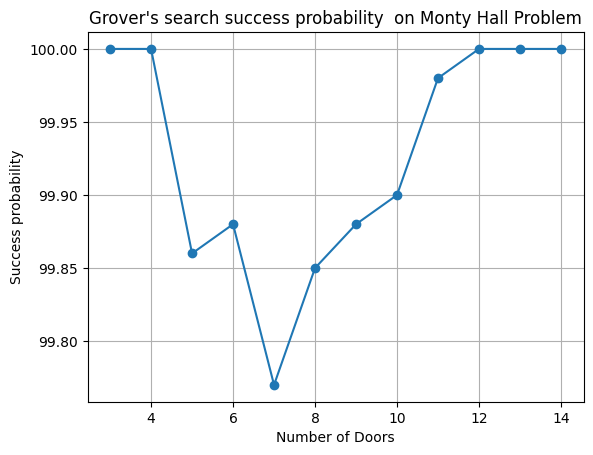

In [39]:
import matplotlib.pyplot as plt

plt.plot(range(3,15), success_probs, marker='o', linestyle='-')

plt.xlabel('Number of Doors')
plt.ylabel('Success probability')

plt.title('Grover\'s search success probability  on Monty Hall Problem')

plt.grid(True)
plt.show()

As we expecteded, the result were great and the algorithm suffers and increase in its general performace.

## 5. Conclussions

We conclude that a quantum algorithm that overcome the classical algorithm for Monty Hall problem is achievable with a variation of Grover's Search, with success probabilities from $85\%$ even up to a $100%$. Not only that, we discover that fixing the amount of doors to specific value that doesn't affect the formulation of the problem improve even more the Grover's Search algorithm, achieving even a success probability of $99.7/%$ or more.